**Alberta OPOKU-FRIMPONG - 10211100409<br>Kwaku Amo-Korankye - 10211100331<br>Class of 2025: Bachelor of Science in Artificial Intelligence<br>AI4226: Intermediate Deep Learning<br>Explainability using GradCAM and SHAP**

Dependency Installation

In [9]:
import torch
import cv2
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms
import shap
import time
from skimage.metrics import structural_similarity as ssim

Model Loading and Class Definition

In [10]:
# Define class labels
classes = ['pituitary', 'bone fractured', 'healthy brain', 'adenocarcinoma', 'glioma', 'benign', 'breast cancer positive', 'bone not fractured', 'squamous cell carcinoma', 'meningioma', 'breast cancer negative']

# Define image transformations (same as validation set)
transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5], std=[0.5])
    ])


# Load the trained model
comprehensive_model = torch.load("/Users/academiccity/Documents/amokorankye/front end/server/comprehensive_model.pth", weights_only=False )
comprehensive_model.eval()  # Set to evaluation mode

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Model Prediction

In [11]:
def predict(image_path, diagnosisArea):
    """
    Predict brain tumor classification for multiple image types
    Supports: jpg, jpeg, png, bmp, tiff
    """
    # Supported image extensions
    SUPPORTED_FORMATS = {'.jpg', '.jpeg', '.png', '.bmp', '.tiff'}
    
    try:
        # Validate file extension
        file_ext = os.path.splitext(image_path)[1].lower()
        if file_ext not in SUPPORTED_FORMATS:
            raise ValueError(f"Unsupported image format. Supported formats: {', '.join(SUPPORTED_FORMATS)}")

        # Load image using PIL first (handles multiple formats better)
        pil_image = Image.open(image_path)
        
        # Convert to RGB if needed
        if pil_image.mode != 'RGB':
            pil_image = pil_image.convert('RGB')
            
        image = pil_image
        
        # Apply transformations
        transformed = transform(image)
        # Add batch dimension and ensure it's the right shape
        image_tensor = transformed.unsqueeze(0)

        # Move tensor to same device as model
        device = next(comprehensive_model.parameters()).device
        image_tensor = image_tensor.to(device)

        # Perform inference
        with torch.no_grad():
            output = comprehensive_model(image_tensor)
            predicted_class = torch.argmax(output, dim=1).item()
            probabilities = torch.nn.functional.softmax(output, dim=1)
            confidence = probabilities[0, predicted_class].item()

        # Return detailed results
        # Filter classes based on diagnosisArea
        if diagnosisArea == "Brain Tumors":
            relevant_classes = ['pituitary', 'healthy brain', 'glioma', 'meningioma']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }

        elif diagnosisArea == "Breast Cancer":
            relevant_classes = ['breast cancer negative', 'breast cancer positive']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }

        elif diagnosisArea == "Bone Fractures":
            relevant_classes = ['bone fractured', 'bone not fractured']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }

        elif diagnosisArea == "Lung Cancer":
            relevant_classes = ['adenocarcinoma', 'benign', 'squamous cell carcinoma']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }        
        else:
            # Default behavior for other areas or when no area is specified
            result = {
            'diagnosis': classes[predicted_class],
            'confidence': confidence,
            'probabilities': {
                classes[i]: probabilities[0, i].item() 
                for i in range(len(classes))
            }
            }
        
        # Print formatted results
        print(f"\nDiagnosis Results:")

        print(f"Classification: {result['diagnosis']}")
        print(f"Confidence: {result['confidence']:.2%}")
        print(f"\nClass Probabilities:")
        for cls, prob in result['probabilities'].items():
            print(f"{cls}: {prob:.2%}")
            
        return result

    except FileNotFoundError:
        print(f"Error: Image file '{image_path}' not found")
        return None
    except Exception as e:
        print(f"Error processing image: {str(e)}")
        return None

Gradcam Implementation

In [12]:
def apply_gradcam(image_path, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1]):
    # Set up GradCAM
    class GradCAM:
        def __init__(self, model, target_layer):
            self.model = model
            self.target_layer = target_layer
            self.gradients = None
            self.features = None
            
            # Register hooks
            self.target_layer.register_forward_hook(self.save_features)
            self.target_layer.register_full_backward_hook(self.save_gradients)
        
        def save_features(self, module, input, output):
            self.features = output
            
        def save_gradients(self, module, grad_input, grad_output):
            self.gradients = grad_output[0]
            
        def generate(self, input_image):
            # Forward pass
            model_output = self.model(input_image)
            predicted_class = torch.argmax(model_output)
            
            # Backward pass
            model_output[:, predicted_class].backward()
            
            # Generate CAM
            pooled_gradients = torch.mean(self.gradients, dim=[0, 2, 3])
            for i in range(self.features.shape[1]):
                self.features[:, i, :, :] *= pooled_gradients[i]
            
            cam = torch.mean(self.features, dim=1).squeeze()
            cam = torch.maximum(cam, torch.zeros_like(cam))  # ReLU
            cam = (cam - cam.min()) / (cam.max() - cam.min())  # Normalize
            
            return cam.detach(), predicted_class  # Detach here

    try:
        # Load image using OpenCV
        image = cv2.imread(image_path)  # OpenCV loads as BGR NumPy array
        if image is None:
            raise ValueError(f"Could not read image from {image_path}")
        
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
        original_size = image.shape[:2]  # Store original size (H, W)

        # Convert NumPy array to PIL Image (required for torchvision transforms)
        pil_image = Image.fromarray(image)

        # Apply transformations
        transformed = transform(pil_image)  # Now it's a PyTorch tensor (C, H, W)
        input_tensor = transformed.unsqueeze(0)  # Add batch dimension (1, C, H, W)

        # Initialize GradCAM
        grad_cam = GradCAM(model, target_layer)

        # Generate heatmap
        cam, predicted_class = grad_cam.generate(input_tensor)
        cam = cam.cpu().numpy()  # Convert to NumPy array

        # Resize heatmap to match original image size
        cam = cv2.resize(cam, (original_size[1], original_size[0]))  # (W, H) format

        # Normalize and apply color map
        heatmap = np.uint8(255 * cam)  # Normalize to [0, 255]
        heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)  # Convert to RGB

        # Blend original image with heatmap
        alpha = 0.5
        superimposed = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)

        # Display results
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

        ax1.imshow(image)
        ax1.set_title('Original Image')
        ax1.axis('off')

        ax2.imshow(heatmap)
        ax2.set_title('GradCAM Heatmap')
        ax2.axis('off')

        ax3.imshow(superimposed)
        ax3.set_title('Superimposed Image')
        ax3.axis('off')

        plt.suptitle(f'Predicted Class: {classes[predicted_class]}')
        plt.tight_layout()
        plt.show()

        return cam  # Return GradCAM output

    except Exception as e:
        print(f"Error applying GradCAM: {str(e)}")
        return None

SHAP Implementation

In [13]:
def apply_shap(image_path, model=comprehensive_model, target_class=None, n_samples=100):
    try:
        # Load and preprocess the image
        pil_image = Image.open(image_path)
        if pil_image.mode != 'RGB':
            pil_image = pil_image.convert('RGB')
        
        # Save original image for display
        original_img = np.array(pil_image.resize((224, 224)))
        
        # Apply transformations
        input_tensor = transform(pil_image).unsqueeze(0)
        
        # Get model prediction
        with torch.no_grad():
            output = model(input_tensor)
            probabilities = torch.nn.functional.softmax(output, dim=1)
            predicted_class = torch.argmax(output, dim=1).item()
        
        # Use predicted class if target_class not specified
        if target_class is None:
            target_class = predicted_class
        
        # Create background distribution
        # For medical imaging, random noise might not be optimal
        # Using a low-intensity uniform distribution as background
        background = torch.zeros((n_samples, 3, 224, 224))
        for i in range(n_samples):
            # Generate random low-intensity background (more appropriate for medical images)
            background[i] = torch.rand((3, 224, 224)) * 0.1 - 0.05
        
        # Initialize GradientExplainer
        e = shap.GradientExplainer(
            (model, model.layer4[-1]),  # Model and target layer (same as GradCAM)
            background
        )
        
        # Get SHAP values - use all classes to avoid index errors
        num_classes = len(classes)  # Use all available classes
        shap_values, indexes = e.shap_values(input_tensor, ranked_outputs=num_classes, nsamples=200)
        
        # The first dimension is the batch, which we'll index into
        # The second dimension has the explanations for all classes
        shap_values = [sv[0] for sv in shap_values]
        
        # Find the index of the target class in the ranked outputs
        class_found = False
        class_idx = 0
        for i in range(indexes.shape[1]):
            if indexes[0, i] == target_class:
                class_idx = i
                class_found = True
                break
        
        if not class_found:
            # Fall back to top predicted class if target class is not found
            print(f"Warning: Target class {target_class} ({classes[target_class]}) not in top predictions.")
            print(f"Using top predicted class instead: {indexes[0, 0]} ({classes[indexes[0, 0]]})")
            class_idx = 0
            target_class = indexes[0, 0]
        
        class_name = classes[target_class]
        shap_for_class = shap_values[class_idx]
        
        # Handle the case where shap_for_class might already be a NumPy array
        if isinstance(shap_for_class, np.ndarray):
            # Already a NumPy array, use directly
            shap_numpy = shap_for_class
        else:
            # Convert PyTorch tensor to NumPy if needed
            shap_numpy = shap_for_class.numpy()
        
        # Print shape information for debugging
        print(f"SHAP values shape: {shap_numpy.shape}")
        
        # Resize SHAP values if they don't match the expected image dimensions
        # Expected shape for RGB image: (3, 224, 224)
        if shap_numpy.shape != (3, 224, 224):
            print(f"Resizing SHAP values from {shap_numpy.shape} to match image dimensions")
            # If SHAP values are from a feature map with different dimensions
            if len(shap_numpy.shape) == 3:  # (C, H, W) format
                resized_shap = np.zeros((3, 224, 224))
                for c in range(min(3, shap_numpy.shape[0])):
                    # Resize each channel separately using OpenCV
                    channel = shap_numpy[c]
                    resized_channel = cv2.resize(channel, (224, 224))
                    resized_shap[c] = resized_channel
                shap_numpy = resized_shap
            elif len(shap_numpy.shape) == 2:  # (H, W) format for grayscale or feature map
                # Resize to 224x224 and replicate to 3 channels for RGB visualization
                resized_channel = cv2.resize(shap_numpy, (224, 224))
                shap_numpy = np.stack([resized_channel] * 3, axis=0)
            else:
                print(f"Warning: Unexpected SHAP value shape: {shap_numpy.shape}")
                # Try to make a best effort reshape/resize
                flattened = shap_numpy.flatten()
                if len(flattened) > 0:
                    # Create dummy values for visualization
                    resized_channel = np.zeros((224, 224))
                    shap_numpy = np.stack([resized_channel] * 3, axis=0)
        
        # SHAP values will be in shape (C, H, W) for RGB images
        # Sum across RGB channels for heatmap
        shap_magnitude = np.sum(np.abs(shap_numpy), axis=0)
        
        # Original image for comparison (denormalize)
        img_tensor = input_tensor[0]
        if isinstance(img_tensor, torch.Tensor):
            img_tensor = img_tensor.numpy()
        img_tensor = img_tensor.transpose(1, 2, 0) 
        img_display = (img_tensor * 0.5) + 0.5  # Adjust based on your normalization
        
        # Create multiple visualization styles
        plt.figure(figsize=(20, 10))
        
        # 1. Original image with prediction
        plt.subplot(2, 3, 1)
        plt.imshow(img_display)
        plt.title(f"Prediction: {class_name}\nProbability: {probabilities[0, target_class]:.2%}")
        plt.axis('off')
        
        # 2. SHAP heatmap overlay
        plt.subplot(2, 3, 2)
        # Normalize heatmap for visualization
        heatmap = shap_magnitude / np.max(shap_magnitude)
        # Create a colored heatmap
        colored_heatmap = plt.cm.jet(heatmap)
        # Set alpha channel based on magnitude
        colored_heatmap[:, :, 3] = 0.7 * heatmap
        # Display original image
        plt.imshow(img_display)
        # Overlay heatmap
        plt.imshow(colored_heatmap)
        plt.title("SHAP Heatmap Overlay")
        plt.axis('off')
        
        # 3. SHAP values as heatmap only
        plt.subplot(2, 3, 3)
        plt.imshow(heatmap, cmap='jet')
        plt.colorbar(label='SHAP Value Magnitude')
        plt.title("SHAP Values Heatmap")
        plt.axis('off')
        
        # 4. Positive and negative contributions (RGB channels visualization)
        plt.subplot(2, 3, 4)
        # Aggregate the SHAP values across RGB channels, keeping sign
        pos_shap = np.maximum(0, np.sum(shap_numpy, axis=0))
        neg_shap = np.minimum(0, np.sum(shap_numpy, axis=0))
        # Normalize for visualization
        pos_norm = pos_shap / (np.max(pos_shap) + 1e-10)
        neg_norm = -neg_shap / (np.max(-neg_shap) + 1e-10)
        # Create RGB image with red for positive, blue for negative
        rgb_shap = np.zeros((224, 224, 3))
        rgb_shap[:, :, 0] = pos_norm  # Red channel for positive
        rgb_shap[:, :, 2] = neg_norm  # Blue channel for negative
        plt.imshow(rgb_shap)
        plt.title("Positive (red) and Negative (blue) Contributions")
        plt.axis('off')
        
        # 5. Channel-specific SHAP values
        plt.subplot(2, 3, 5)
        # Show separate contributions from R, G, B channels
        channel_abs = np.abs(shap_numpy)
        channel_abs_max = np.max(channel_abs)
        r_channel = channel_abs[0] / channel_abs_max
        g_channel = channel_abs[1] / channel_abs_max
        b_channel = channel_abs[2] / channel_abs_max
        # Create RGB image showing channel contributions
        channel_vis = np.stack([r_channel, g_channel, b_channel], axis=2)
        plt.imshow(channel_vis)
        plt.title("Channel Contributions (R, G, B)")
        plt.axis('off')
        
        # 6. Thresholded SHAP values
        plt.subplot(2, 3, 6)
        # Only show areas with high SHAP values
        threshold = 0.5 * np.max(shap_magnitude)
        mask = shap_magnitude > threshold
        # Create image with transparent background
        masked_image = img_display.copy()
        # Add highlight to areas with high SHAP values
        highlight = np.zeros_like(masked_image)
        highlight[mask] = [1, 0.5, 0]  # Orange highlight
        # Blend with original image
        alpha = 0.7
        highlighted = masked_image * (1-alpha) + highlight * alpha
        plt.imshow(highlighted)
        plt.title("Areas of High Importance")
        plt.axis('off')
        
        plt.suptitle(f"SHAP Explanations for {class_name} Prediction", fontsize=16)
        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()
        
        # Try to use the built-in SHAP image plot function if possible
        try:
            plt.figure(figsize=(10, 6))
            # Only attempt this if SHAP values are in the right format
            if shap_numpy.shape == (3, 224, 224):
                # Reshape the SHAP values to match the library's expectations
                image_plot_data = shap_numpy.transpose(1, 2, 0)  # Change from (C,H,W) to (H,W,C)
                shap.image_plot(image_plot_data, img_display, show=False)
                plt.suptitle(f"SHAP Image Plot for {class_name}", fontsize=16)
                plt.tight_layout()
                plt.show()
            else:
                print("Skipping shap.image_plot due to incompatible SHAP value dimensions")
        except Exception as e:
            print(f"Could not create SHAP image plot: {str(e)}")
        
        return shap_numpy, img_display
        
    except Exception as e:
        print(f"Error applying SHAP: {str(e)}")
        import traceback
        traceback.print_exc()
        return None, None

Image Pipeline

In [14]:
def image_pipeline(image_path, diagnosisArea, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1], use_gradcam=True, use_shap=True):
    # Run prediction
    print("\n=== Prediction Results ===")
    prediction_result = predict(image_path, diagnosisArea)
    
    # Apply explainability methods as requested
    if use_gradcam:
        print("\n=== GradCAM Visualization ===")
        gradcam_result = apply_gradcam(image_path, model, target_layer)
    
    if use_shap:
        print("\n=== SHAP Visualization ===")
        # Get the index of the predicted class based on diagnosisArea
        if diagnosisArea == "Brain Tumors":
            relevant_classes = ['pituitary', 'healthy brain', 'glioma', 'meningioma']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        elif diagnosisArea == "Breast Cancer":
            relevant_classes = ['breast cancer negative', 'breast cancer positive']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        elif diagnosisArea == "Bone Fractures":
            relevant_classes = ['bone fractured', 'bone not fractured']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        elif diagnosisArea == "Lung Cancer":
            relevant_classes = ['adenocarcinoma', 'benign', 'squamous cell carcinoma']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        else:
            target_class = None  # Let SHAP use the top predicted class
            
        shap_result, shap_image = apply_shap(image_path, model, target_class)
    
    return prediction_result

Model Trial


=== Prediction Results ===

Diagnosis Results:
Classification: glioma
Confidence: 92.53%

Class Probabilities:
pituitary: 7.38%
healthy brain: 0.00%
glioma: 92.53%
meningioma: 0.09%

=== GradCAM Visualization ===


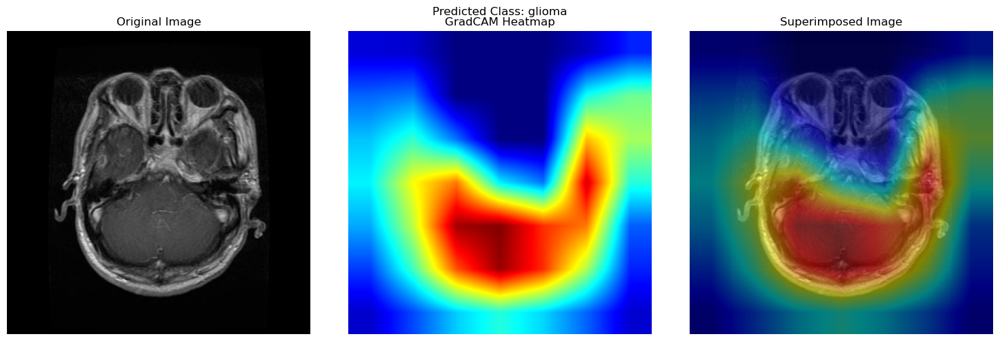


=== SHAP Visualization ===
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


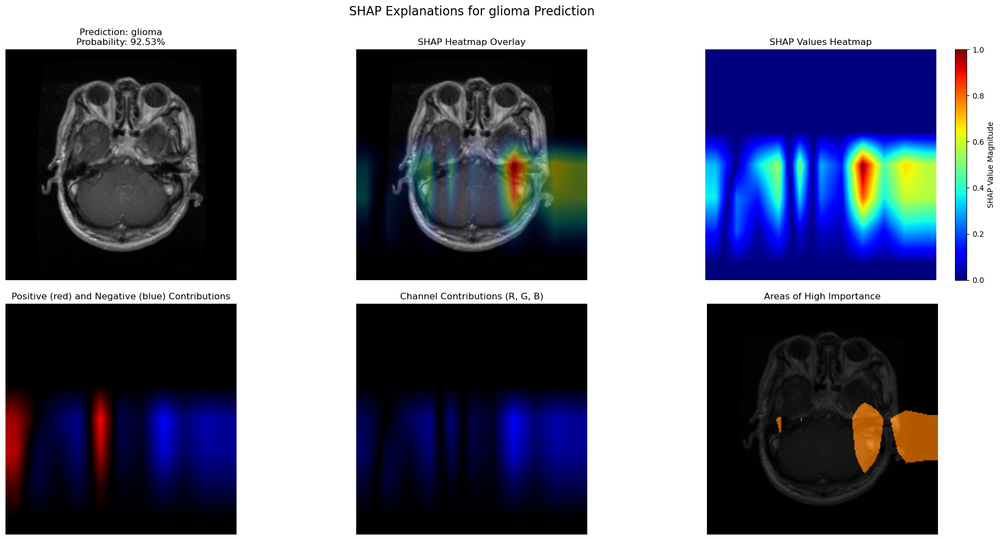

/var/folders/2z/km3f0zgd0hzf9zk_ctnxyzzw0000gn/T/ipykernel_13908/146183786.py:205: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


<Figure size 1000x600 with 0 Axes>

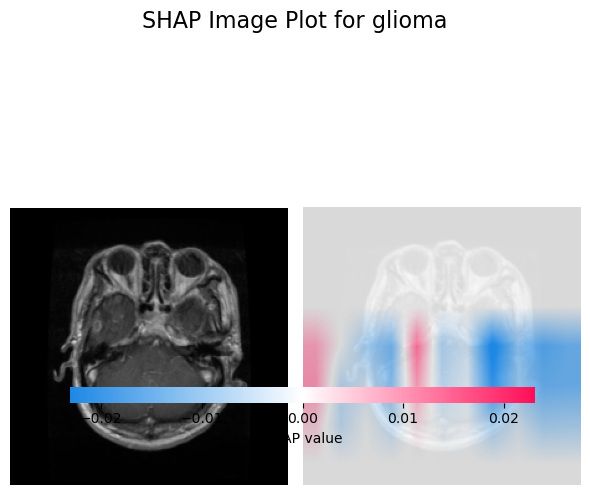

{'diagnosis': 'glioma',
 'confidence': 0.9252514243125916,
 'probabilities': {'pituitary': 0.07378064841032028,
  'healthy brain': 8.657639796183503e-07,
  'glioma': 0.9252514243125916,
  'meningioma': 0.0008708746754564345}}

In [15]:
image_pipeline(
    image_path = "/Users/academiccity/Documents/amokorankye/deep learning final exam/test data/glioma/glioma.jpg", 
    diagnosisArea = "Brain Tumors", 
    model=comprehensive_model, 
    target_layer=comprehensive_model.layer4[-1],
    use_gradcam=True,
    use_shap=True
)

Model Evaluation

In [16]:
def evaluate_classification_model(model=comprehensive_model, test_dir=None, batch_size=32):
    """
    Evaluate the classification model using standard metrics:
    - Accuracy
    - Precision, Recall, F1-score
    - Confusion Matrix
    - ROC AUC (for multi-class, we'll use one-vs-rest)
    """
    from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve
    from torch.utils.data import DataLoader, Dataset
    import seaborn as sns
    from tqdm.notebook import tqdm
    
    class TestDataset(Dataset):
        """Custom dataset to load test images from directory"""
        def __init__(self, test_dir, transform=transform):
            self.test_dir = test_dir
            self.transform = transform
            self.image_paths = []
            self.labels = []
            
            # Example structure: test_dir/class_name/image.jpg
            for class_idx, class_name in enumerate(classes):
                class_dir = os.path.join(test_dir, class_name)
                if os.path.isdir(class_dir):
                    for img_name in os.listdir(class_dir):
                        if img_name.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
                            self.image_paths.append(os.path.join(class_dir, img_name))
                            self.labels.append(class_idx)
            
        def __len__(self):
            return len(self.image_paths)
        
        def __getitem__(self, idx):
            image_path = self.image_paths[idx]
            label = self.labels[idx]
            
            # Load and transform image
            image = Image.open(image_path)
            if image.mode != 'RGB':
                image = image.convert('RGB')
            
            if self.transform:
                image = self.transform(image)
                
            return image, label
    
    # If no test directory is provided, show a message
    if test_dir is None:
        print("Please provide a test_dir path to evaluate the model on a test dataset.")
        print("Skipping evaluation metrics that require a test dataset.")
        return
    
    # Initialize test dataset and dataloader
    test_dataset = TestDataset(test_dir)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    
    # Set model to evaluation mode
    model.eval()
    
    # Lists to store predictions and true labels
    all_preds = []
    all_labels = []
    all_probs = []
    
    # Perform inference
    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc="Evaluating model"):
            # Move data to the same device as model
            device = next(model.parameters()).device
            images = images.to(device)
            
            # Forward pass
            outputs = model(images)
            probs = torch.nn.functional.softmax(outputs, dim=1)
            preds = torch.argmax(outputs, dim=1)
            
            # Store results
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())
            all_probs.extend(probs.cpu().numpy())
    
    # Convert to numpy arrays for easier handling
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)
    all_probs = np.array(all_probs)
    
    # Calculate metrics
    accuracy = accuracy_score(all_labels, all_preds)
    
    # Print classification report
    print("\n=== Classification Report ===")
    print(classification_report(all_labels, all_preds, target_names=classes))
    
    # Calculate confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    
    # Plot confusion matrix
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
    
    # Calculate ROC AUC (one vs rest for multi-class)
    try:
        # One-hot encode the labels for ROC AUC calculation
        roc_auc = roc_auc_score(
            np.eye(len(classes))[all_labels],  # Convert to one-hot encoding
            all_probs,
            multi_class='ovr'
        )
        print(f"\nROC AUC Score (One-vs-Rest): {roc_auc:.4f}")
        
        # Plot ROC curves for each class
        plt.figure(figsize=(12, 8))
        for i, class_name in enumerate(classes):
            y_true = (all_labels == i).astype(int)
            y_score = all_probs[:, i]
            
            fpr, tpr, _ = roc_curve(y_true, y_score)
            plt.plot(fpr, tpr, label=f"{class_name} (AUC: {roc_auc_score(y_true, y_score):.4f})")
        
        plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curves (One-vs-Rest)')
        plt.legend(loc="lower right")
        plt.show()
    except Exception as e:
        print(f"Error calculating ROC AUC: {e}")

    # Print summary metrics
    print("\n=== Summary Metrics ===")
    print(f"Accuracy: {accuracy:.4f}")
    
    return {
        "accuracy": accuracy,
        "predictions": all_preds,
        "true_labels": all_labels,
        "probabilities": all_probs
    }

GradCAM Evaluation

In [17]:
def evaluate_gradcam_quality(image_paths, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1]):
    """
    Evaluate GradCAM by comparing localization with random baseline
    and measuring IoU with ground truth masks if available
    """
    import time
    from skimage.metrics import structural_similarity as ssim
    
    # Check if we have a list of paths or a single path
    if isinstance(image_paths, str):
        image_paths = [image_paths]
        
    results = []
    
    for image_path in image_paths:
        print(f"Evaluating GradCAM for: {os.path.basename(image_path)}")
        
        # Measure execution time
        start_time = time.time()
        cam = apply_gradcam(image_path, model, target_layer)
        execution_time = time.time() - start_time
        
        if cam is None:
            print(f"GradCAM failed for {image_path}")
            continue
            
        # Generate a random baseline heatmap for comparison
        random_heatmap = np.random.random(cam.shape)
        
        # Load original image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Could not load image from {image_path}")
            continue
            
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Resize cam to match image dimensions if needed
        if cam.shape != (image.shape[0], image.shape[1]):
            cam = cv2.resize(cam, (image.shape[1], image.shape[0]))
        
        # Measure energy concentration in heatmap
        # A good heatmap should have its energy concentrated in fewer pixels
        cam_sorted = np.sort(cam.flatten())[::-1]  # Sort in descending order
        energy_concentration = np.sum(cam_sorted[:int(0.2*len(cam_sorted))]) / np.sum(cam_sorted)
        
        # Heatmap entropy - lower entropy means more focused attention
        eps = 1e-10  # Small constant to avoid log(0)
        normalized_cam = cam / (np.sum(cam) + eps)
        entropy = -np.sum(normalized_cam * np.log(normalized_cam + eps))
        
        # Generate binary mask from heatmap using Otsu's method
        cam_uint8 = (cam * 255).astype(np.uint8)
        _, binary_mask = cv2.threshold(cam_uint8, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        
        # Check if a ground truth segmentation mask is available
        mask_path = image_path.replace('.jpg', '_mask.png').replace('.jpeg', '_mask.png').replace('.png', '_mask.png')
        has_gt_mask = os.path.exists(mask_path)
        iou_score = None
        
        if has_gt_mask:
            # Load and preprocess ground truth mask
            gt_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            gt_mask = cv2.resize(gt_mask, (binary_mask.shape[1], binary_mask.shape[0]))
            gt_mask = (gt_mask > 0).astype(np.uint8)
            
            # Calculate IoU (Intersection over Union)
            intersection = np.logical_and(binary_mask, gt_mask).sum()
            union = np.logical_or(binary_mask, gt_mask).sum()
            iou_score = intersection / (union + eps)
            
            print(f"IoU with ground truth: {iou_score:.4f}")
        
        # Compare with random baseline using structural similarity
        ssim_random = ssim(cam, random_heatmap, data_range=1.0)
        
        # Store results
        result = {
            "image_path": image_path,
            "execution_time": execution_time,
            "energy_concentration": energy_concentration,
            "entropy": entropy,
            "ssim_random": ssim_random,
            "has_gt_mask": has_gt_mask,
            "iou_score": iou_score
        }
        results.append(result)
        
        # Print results
        print(f"Execution time: {execution_time:.4f} seconds")
        print(f"Energy concentration: {energy_concentration:.4f}")
        print(f"Entropy: {entropy:.4f}")
        print(f"SSIM with random baseline: {ssim_random:.4f}")
        print("-" * 40)
    
    # Calculate average metrics
    if results:
        avg_execution_time = np.mean([r["execution_time"] for r in results])
        avg_energy = np.mean([r["energy_concentration"] for r in results])
        avg_entropy = np.mean([r["entropy"] for r in results])
        avg_ssim = np.mean([r["ssim_random"] for r in results])
        
        # Calculate average IoU if ground truth masks are available
        iou_scores = [r["iou_score"] for r in results if r["iou_score"] is not None]
        avg_iou = np.mean(iou_scores) if iou_scores else None
        
        print("\n=== GradCAM Evaluation Summary ===")
        print(f"Average execution time: {avg_execution_time:.4f} seconds")
        print(f"Average energy concentration: {avg_energy:.4f} (higher is better)")
        print(f"Average entropy: {avg_entropy:.4f} (lower is better)")
        print(f"Average SSIM with random baseline: {avg_ssim:.4f} (lower is better)")
        if avg_iou is not None:
            print(f"Average IoU with ground truth: {avg_iou:.4f} (higher is better)")
    
    return results

SHAP Evaluation

In [18]:
def evaluate_shap_quality(image_paths, model=comprehensive_model, n_samples=100):
    """
    Evaluate SHAP explanations quality using various metrics
    """
    import time
    from skimage.metrics import structural_similarity as ssim
    
    # Check if we have a list of paths or a single path
    if isinstance(image_paths, str):
        image_paths = [image_paths]
    
    results = []
    
    for image_path in image_paths:
        print(f"Evaluating SHAP for: {os.path.basename(image_path)}")
        
        # Determine diagnosis area from the image path or filename
        # This is a simplification - adjust based on your actual organization
        filename = os.path.basename(image_path).lower()
        if any(x in filename for x in ['glioma', 'meningioma', 'pituitary']):
            diagnosisArea = "Brain Tumors"
        elif any(x in filename for x in ['breast']):
            diagnosisArea = "Breast Cancer"
        elif any(x in filename for x in ['bone', 'fracture']):
            diagnosisArea = "Bone Fractures"
        elif any(x in filename for x in ['adenocarcinoma', 'squamous']):
            diagnosisArea = "Lung Cancer"
        else:
            diagnosisArea = None
            
        # Get prediction for the image
        pred_result = predict(image_path, diagnosisArea)
        if not pred_result:
            print(f"Prediction failed for {image_path}")
            continue
            
        # Get target class from prediction
        target_class = classes.index(pred_result['diagnosis']) if pred_result['diagnosis'] in classes else None
        
        # Measure execution time
        start_time = time.time()
        shap_values, img_display = apply_shap(image_path, model, target_class, n_samples=n_samples)
        execution_time = time.time() - start_time
        
        if shap_values is None:
            print(f"SHAP analysis failed for {image_path}")
            continue
        
        # Aggregate SHAP values across channels
        shap_magnitude = np.sum(np.abs(shap_values), axis=0)
        
        # Normalize for easier analysis
        shap_norm = shap_magnitude / np.max(shap_magnitude)
        
        # Generate a random baseline for comparison
        random_shap = np.random.random(shap_norm.shape)
        
        # Compute metrics
        
        # 1. Energy concentration (how focused the explanation is)
        shap_sorted = np.sort(shap_norm.flatten())[::-1]  # Sort in descending order
        energy_concentration = np.sum(shap_sorted[:int(0.2*len(shap_sorted))]) / np.sum(shap_sorted)
        
        # 2. Entropy (lower is better, more focused)
        eps = 1e-10  # Small constant to avoid log(0)
        normalized_shap = shap_norm / (np.sum(shap_norm) + eps)
        entropy = -np.sum(normalized_shap * np.log(normalized_shap + eps))
        
        # 3. SSIM with random baseline (lower is better)
        ssim_random = ssim(shap_norm, random_shap, data_range=1.0)
        
        # 4. Sparsity (percentage of values near zero)
        sparsity = np.mean(shap_norm < 0.1)
        
        # Check if we have a ground truth segmentation mask available
        mask_path = image_path.replace('.jpg', '_mask.png').replace('.jpeg', '_mask.png').replace('.png', '_mask.png')
        has_gt_mask = os.path.exists(mask_path)
        iou_score = None
        
        if has_gt_mask:
            # Create binary mask from SHAP values using Otsu's method
            shap_uint8 = (shap_norm * 255).astype(np.uint8)
            _, shap_binary = cv2.threshold(shap_uint8, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
            
            # Load and preprocess ground truth mask
            gt_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            gt_mask = cv2.resize(gt_mask, (shap_binary.shape[1], shap_binary.shape[0]))
            gt_mask = (gt_mask > 0).astype(np.uint8)
            
            # Calculate IoU (Intersection over Union)
            intersection = np.logical_and(shap_binary, gt_mask).sum()
            union = np.logical_or(shap_binary, gt_mask).sum()
            iou_score = intersection / (union + eps)
            
            print(f"IoU with ground truth: {iou_score:.4f}")
        
        # Store results
        result = {
            "image_path": image_path,
            "execution_time": execution_time,
            "energy_concentration": energy_concentration,
            "entropy": entropy,
            "ssim_random": ssim_random,
            "sparsity": sparsity,
            "has_gt_mask": has_gt_mask,
            "iou_score": iou_score
        }
        results.append(result)
        
        # Print results
        print(f"Execution time: {execution_time:.4f} seconds")
        print(f"Energy concentration: {energy_concentration:.4f}")
        print(f"Entropy: {entropy:.4f}")
        print(f"SSIM with random baseline: {ssim_random:.4f}")
        print(f"Sparsity: {sparsity:.4f}")
        print("-" * 40)
    
    # Calculate average metrics
    if results:
        avg_execution_time = np.mean([r["execution_time"] for r in results])
        avg_energy = np.mean([r["energy_concentration"] for r in results])
        avg_entropy = np.mean([r["entropy"] for r in results])
        avg_ssim = np.mean([r["ssim_random"] for r in results])
        avg_sparsity = np.mean([r["sparsity"] for r in results])
        
        # Calculate average IoU if ground truth masks are available
        iou_scores = [r["iou_score"] for r in results if r["iou_score"] is not None]
        avg_iou = np.mean(iou_scores) if iou_scores else None
        
        print("\n=== SHAP Evaluation Summary ===")
        print(f"Average execution time: {avg_execution_time:.4f} seconds")
        print(f"Average energy concentration: {avg_energy:.4f} (higher is better)")
        print(f"Average entropy: {avg_entropy:.4f} (lower is better)")
        print(f"Average SSIM with random baseline: {avg_ssim:.4f} (lower is better)")
        print(f"Average sparsity: {avg_sparsity:.4f} (context dependent)")
        if avg_iou is not None:
            print(f"Average IoU with ground truth: {avg_iou:.4f} (higher is better)")
    
    return results

SHAP and GradCAM Evaluation

In [19]:
def compare_explainability_methods(image_path, diagnosisArea, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1]):
    """
    Compare GradCAM and SHAP explanations for the same image and prediction
    """
    # Get prediction
    prediction_result = predict(image_path, diagnosisArea)
    if not prediction_result:
        print("Prediction failed")
        return None
    
    # Get the index of the predicted class
    class_name = prediction_result['diagnosis']
    target_class = classes.index(class_name) if class_name in classes else None
    
    print(f"\n=== Comparing Explainability Methods for {os.path.basename(image_path)} ===")
    print(f"Predicted class: {class_name} (confidence: {prediction_result['confidence']:.2%})")
    
    # Generate GradCAM
    print("\nGenerating GradCAM...")
    gradcam_start = time.time()
    cam = apply_gradcam(image_path, model, target_layer)
    gradcam_time = time.time() - gradcam_start
    print(f"GradCAM generation time: {gradcam_time:.4f} seconds")
    
    # Generate SHAP
    print("\nGenerating SHAP explanation...")
    shap_start = time.time()
    shap_values, img_display = apply_shap(image_path, model, target_class)
    shap_time = time.time() - shap_start
    print(f"SHAP generation time: {shap_time:.4f} seconds")
    
    if cam is None or shap_values is None:
        print("One or both explainability methods failed")
        return None
    
    # Process explanations for comparison
    # Resize GradCAM to match SHAP dimensions if needed
    if cam.shape != (224, 224):
        cam = cv2.resize(cam, (224, 224))
    
    # Get SHAP magnitude
    shap_magnitude = np.sum(np.abs(shap_values), axis=0)
    
    # Normalize both for fair comparison
    cam_norm = cam / np.max(cam)
    shap_norm = shap_magnitude / np.max(shap_magnitude)
    
    # Compute similarity between the two explanations
    correlation = np.corrcoef(cam_norm.flatten(), shap_norm.flatten())[0, 1]
    ssim_value = ssim(cam_norm, shap_norm, data_range=1.0)
    
    # Compare focus areas
    # Get top 20% of highlighted areas in each method
    cam_top = cam_norm > np.percentile(cam_norm, 80)
    shap_top = shap_norm > np.percentile(shap_norm, 80)
    
    # IoU between top regions
    intersection = np.logical_and(cam_top, shap_top).sum()
    union = np.logical_or(cam_top, shap_top).sum()
    iou = intersection / union if union > 0 else 0
    
    # Visual comparison
    plt.figure(figsize=(15, 10))
    
    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(img_display)
    plt.title("Original Image")
    plt.axis('off')
    
    # GradCAM heatmap
    plt.subplot(2, 3, 2)
    plt.imshow(cam_norm, cmap='jet')
    plt.title("GradCAM Heatmap")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')
    
    # SHAP heatmap
    plt.subplot(2, 3, 3)
    plt.imshow(shap_norm, cmap='jet')
    plt.title("SHAP Heatmap")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')
    
    # Difference map
    plt.subplot(2, 3, 4)
    diff_map = cam_norm - shap_norm
    plt.imshow(diff_map, cmap='coolwarm', vmin=-1, vmax=1)
    plt.title("Difference (GradCAM - SHAP)")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')
    
    # Top regions GradCAM
    plt.subplot(2, 3, 5)
    plt.imshow(img_display)
    plt.imshow(np.ma.masked_where(~cam_top, np.ones_like(cam_top)), 
               cmap='autumn', alpha=0.7)
    plt.title("GradCAM Top 20% Regions")
    plt.axis('off')
    
    # Top regions SHAP
    plt.subplot(2, 3, 6)
    plt.imshow(img_display)
    plt.imshow(np.ma.masked_where(~shap_top, np.ones_like(shap_top)), 
               cmap='winter', alpha=0.7)
    plt.title("SHAP Top 20% Regions")
    plt.axis('off')
    
    plt.suptitle(
        f"Comparison of GradCAM and SHAP Explanations\n"
        f"Correlation: {correlation:.4f}, SSIM: {ssim_value:.4f}, IoU of Top Regions: {iou:.4f}",
        fontsize=16
    )
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    # Print comparison metrics
    print("\n=== Explainability Methods Comparison ===")
    print(f"Correlation between heatmaps: {correlation:.4f}")
    print(f"SSIM between heatmaps: {ssim_value:.4f}")
    print(f"IoU of top 20% regions: {iou:.4f}")
    print(f"GradCAM execution time: {gradcam_time:.4f} seconds")
    print(f"SHAP execution time: {shap_time:.4f} seconds")
    
    return {
        "correlation": correlation,
        "ssim": ssim_value,
        "iou": iou,
        "gradcam_time": gradcam_time,
        "shap_time": shap_time
    }

Model Evaluation


=== Running Image-by-Image Model Evaluation ===


Evaluating model:   0%|          | 0/281 [00:00<?, ?it/s]


=== Classification Report ===
                         precision    recall  f1-score   support

              pituitary       0.99      1.00      0.99       265
         bone fractured       1.00      1.00      1.00       343
          healthy brain       1.00      1.00      1.00       300
         adenocarcinoma       1.00      1.00      1.00       750
                 glioma       1.00      0.99      1.00       244
                 benign       1.00      1.00      1.00       750
 breast cancer positive       0.87      0.85      0.86       175
     bone not fractured       1.00      1.00      1.00       334
squamous cell carcinoma       1.00      1.00      1.00       750
             meningioma       1.00      0.99      0.99       248
 breast cancer negative       0.92      0.93      0.93       335

               accuracy                           0.99      4494
              macro avg       0.98      0.98      0.98      4494
           weighted avg       0.99      0.99      0.99   

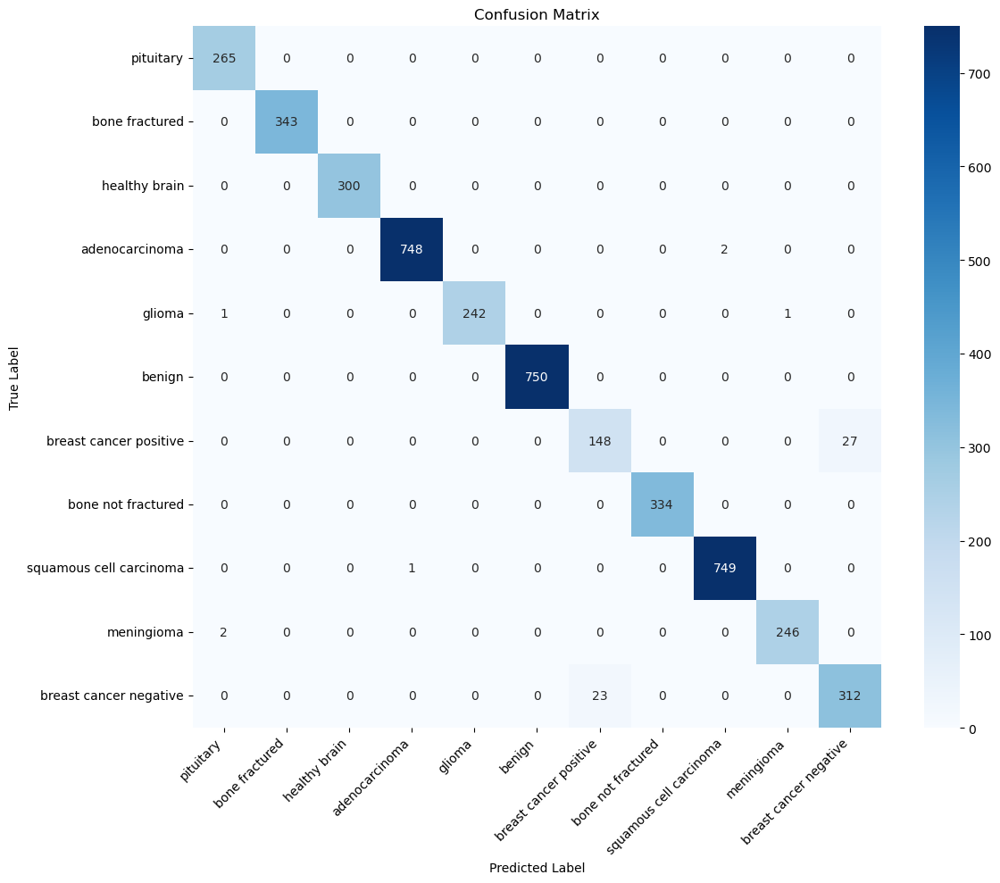


ROC AUC Score (One-vs-Rest): 0.9994


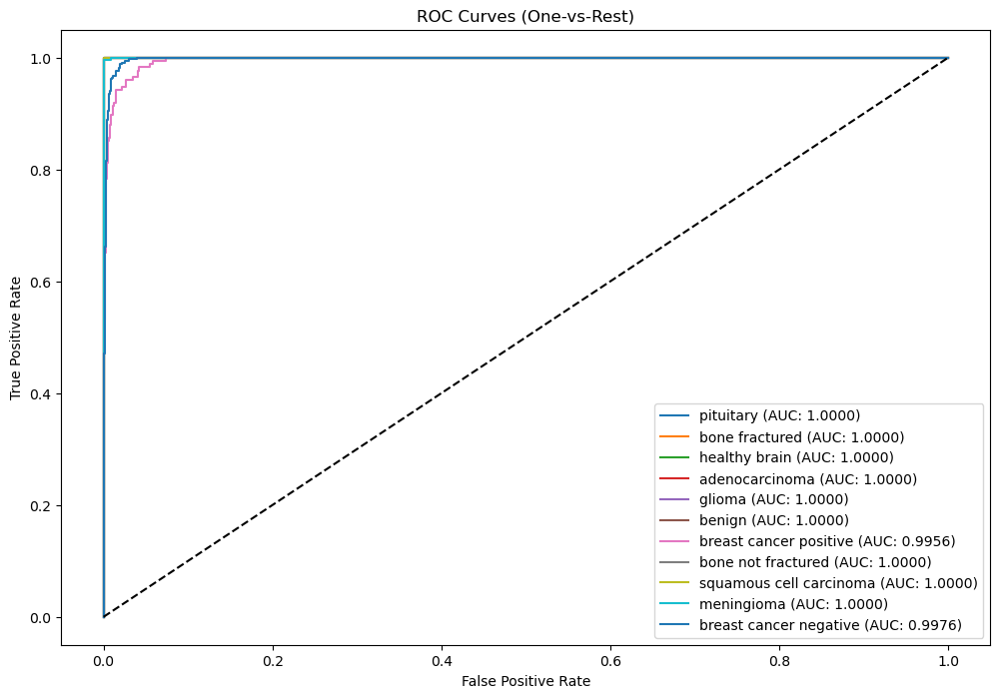


=== Summary Metrics ===
Accuracy: 0.9873
Overall model accuracy on test set: 0.9873
Found 4494 images in the test directory


Processing images:   0%|          | 0/4494 [00:00<?, ?it/s]


Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

Diagnosis Results:
Classification: pitu

,Image,Path,True Class,Predicted Class,Confidence,Diagnosis Area,Prob_pituitary,Prob_healthy brain,Prob_glioma,Prob_meningioma,Prob_bone fractured,Prob_bone not fractured,Prob_adenocarcinoma,Prob_benign,Prob_squamous cell carcinoma,Prob_breast cancer negative,Prob_breast cancer positive
0,0717.jpg,/Users/academiccity/Documents/amokorankye/fina...,pituitary,pituitary,1.000000,Brain Tumors,1.000000,3.051753e-13,3.210387e-11,2.541284e-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0924.jpg,/Users/academiccity/Documents/amokorankye/fina...,pituitary,pituitary,1.000000,Brain Tumors,1.000000,6.508251e-13,4.508790e-12,1.107911e-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1384.jpg,/Users/academiccity/Documents/amokorankye/fina...,pituitary,pituitary,1.000000,Brain Tumors,1.000000,3.072254e-12,5.104745e-08,4.791177e-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0515.jpg,/Users/academiccity/Documents/amokorankye/fina...,pituitary,pituitary,1.000000,Brain Tumors,1.000000,1.526983e-15,4.078049e-11,4.065910e-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0273.jpg,/Users/academiccity/Documents/amokorankye/fina...,pituitary,pituitary,0.999955,Brain Tumors,0.999955,4.347106e-10,4.518679e-05,2.495222e-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4489,2460_1258092255_png.rf.e59e6081399a9dccaa460e3...,/Users/academiccity/Documents/amokorankye/fina...,breast cancer negative,breast cancer negative,0.998992,Breast Cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.998992,0.000934
4490,397_1789866598_png.rf.40cfbab4891d9e9f784d340c...,/Users/academiccity/Documents/amokorankye/fina...,breast cancer negative,breast cancer negative,0.972609,Breast Cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.972609,0.027351
4491,2003_1464197046_png.rf.0faeeb827c16f04e7b4a80d...,/Users/academiccity/Documents/amokorankye/fina...,breast cancer negative,breast cancer negative,0.940605,Breast Cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.940605,0.059378
4492,2526_1760302830_png.rf.24bfe2212ac96bb3ebaf3ab...,/Users/academiccity/Documents/amokorankye/fina...,breast cancer negative,breast cancer negative,0.906494,Breast Cancer,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.906494,0.093324


In [20]:
import os
from tqdm.notebook import tqdm
import pandas as pd

# Model Evaluation - Individual Image Processing
print("\n=== Running Image-by-Image Model Evaluation ===")

# Path to test dataset 
test_data_dir = "/Users/academiccity/Documents/amokorankye/final models/dataset/test"

# First run standard evaluation if the test directory has class subdirectories
if os.path.exists(test_data_dir):
    try:
        # Standard evaluation - treats the directory structure as test_dir/class_name/images.jpg
        eval_results = evaluate_classification_model(
            model=comprehensive_model, 
            test_dir=test_data_dir, 
            batch_size=16
        )
        
        if eval_results:
            accuracy = eval_results["accuracy"]
            print(f"Overall model accuracy on test set: {accuracy:.4f}")
    except Exception as e:
        print(f"Standard evaluation failed: {str(e)}")
        print("Proceeding with individual image evaluation...")

# Now let's iterate through all images in the test directory, regardless of structure

# Initialize lists to store results
all_images = []
image_classes = {}  # Map from image path to class (if determinable from directory structure)

# Function to recursively find all image files
def find_all_images(directory):
    images = []
    for root, _, files in os.walk(directory):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
                full_path = os.path.join(root, file)
                images.append(full_path)
                
                # Try to determine class from directory structure
                parent_dir = os.path.basename(os.path.dirname(full_path))
                if parent_dir in classes:
                    image_classes[full_path] = parent_dir
                    
    return images

# Get all image files
all_images = find_all_images(test_data_dir)
print(f"Found {len(all_images)} images in the test directory")

# Process each image
results = []

for img_path in tqdm(all_images, desc="Processing images"):
    # Try to determine true class from directory structure
    true_class = image_classes.get(img_path, None)
    
    # Determine diagnosis area based on file name or directory
    filename = os.path.basename(img_path).lower()
    parent_dir = os.path.basename(os.path.dirname(img_path)).lower()
    
    if any(x in filename for x in ['glioma', 'meningioma', 'pituitary']) or any(x in parent_dir for x in ['glioma', 'meningioma', 'pituitary', 'brain']):
        diagnosisArea = "Brain Tumors"
    elif any(x in filename for x in ['breast']) or 'breast' in parent_dir:
        diagnosisArea = "Breast Cancer"
    elif any(x in filename for x in ['bone', 'fracture']) or any(x in parent_dir for x in ['bone', 'fracture']):
        diagnosisArea = "Bone Fractures"
    elif any(x in filename for x in ['adenocarcinoma', 'squamous', 'benign', 'lung']) or any(x in parent_dir for x in ['adenocarcinoma', 'squamous', 'benign', 'lung']):
        diagnosisArea = "Lung Cancer"
    else:
        # If no specific diagnosis area can be determined, use None
        diagnosisArea = None
    
    # Run prediction
    try:
        pred_result = predict(img_path, diagnosisArea)
        if pred_result:
            result = {
                'Image': os.path.basename(img_path),
                'Path': img_path,
                'True Class': true_class,
                'Predicted Class': pred_result['diagnosis'],
                'Confidence': pred_result['confidence'],
                'Diagnosis Area': diagnosisArea
            }
            
            # Add detailed probabilities
            for cls, prob in pred_result.get('probabilities', {}).items():
                result[f'Prob_{cls}'] = prob
                
            results.append(result)
    except Exception as e:
        print(f"Error processing {img_path}: {str(e)}")
    
# Create DataFrame from results
results_df = pd.DataFrame(results)

# Display summary statistics
if len(results_df) > 0:
    print("\n=== Image Evaluation Summary ===")
    print(f"Total images processed: {len(results_df)}")
    print(f"Average prediction confidence: {results_df['Confidence'].mean():.4f}")
    
    # Check accuracy if true classes are available
    if 'True Class' in results_df.columns and not results_df['True Class'].isna().all():
        correct = (results_df['True Class'] == results_df['Predicted Class']).sum()
        total = results_df['True Class'].notna().sum()
        accuracy = correct / total if total > 0 else float('nan')
        print(f"Accuracy on labeled images: {accuracy:.4f} ({correct}/{total})")
    
    # Group by diagnosis area
    if 'Diagnosis Area' in results_df.columns:
        print("\n=== Results by Diagnosis Area ===")
        area_counts = results_df['Diagnosis Area'].value_counts()
        for area, count in area_counts.items():
            area_df = results_df[results_df['Diagnosis Area'] == area]
            print(f"{area}: {count} images, Avg. Confidence = {area_df['Confidence'].mean():.4f}")
    
    # Save full results dataframe for further analysis
    image_evaluation_results = results_df
    display(results_df)
else:
    print("No results were generated. Check for errors in the processing.")

Evaluation Loop

Found 11 images for evaluation


Evaluating images:   0%|          | 0/11 [00:00<?, ?it/s]


Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%


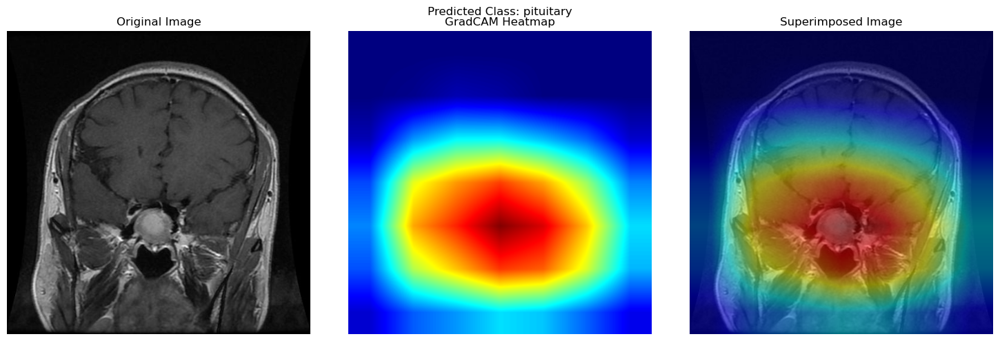

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


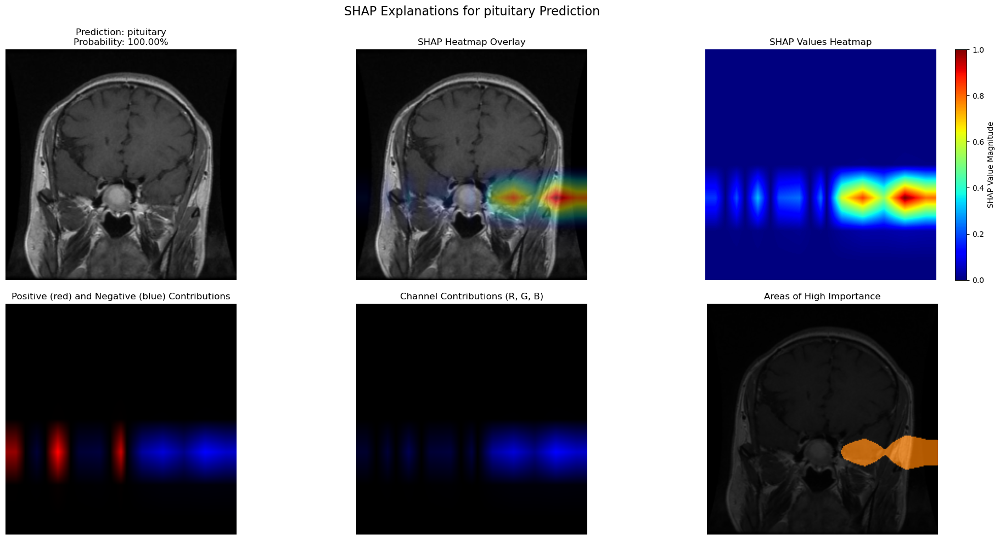

/var/folders/2z/km3f0zgd0hzf9zk_ctnxyzzw0000gn/T/ipykernel_13908/146183786.py:205: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


<Figure size 1000x600 with 0 Axes>

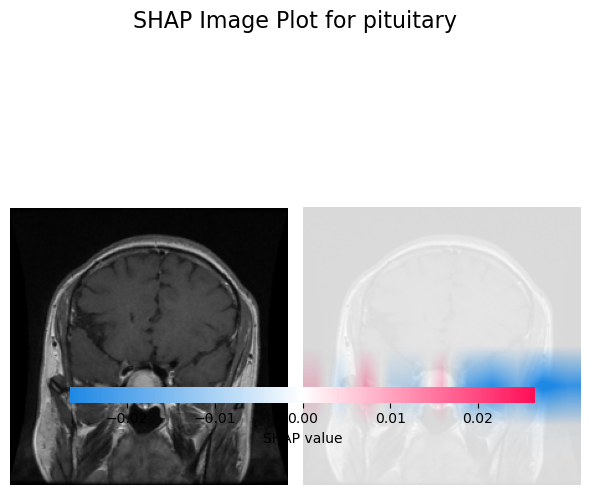


Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

=== Comparing Explainability Methods for pituitary.jpg ===
Predicted class: pituitary (confidence: 100.00%)

Generating GradCAM...


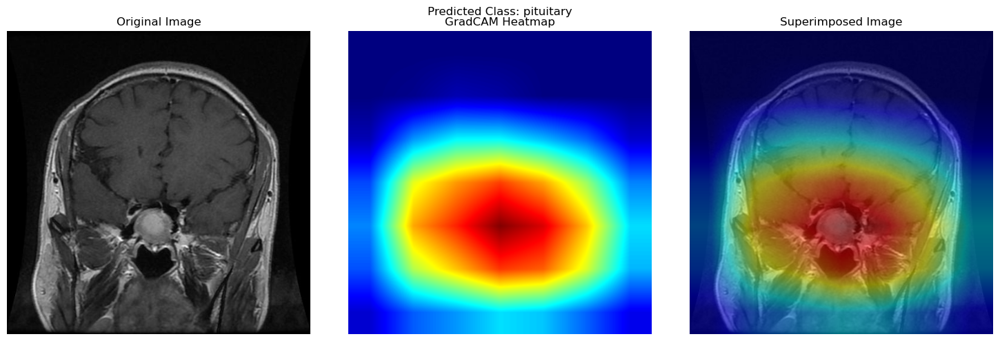

GradCAM generation time: 0.1993 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


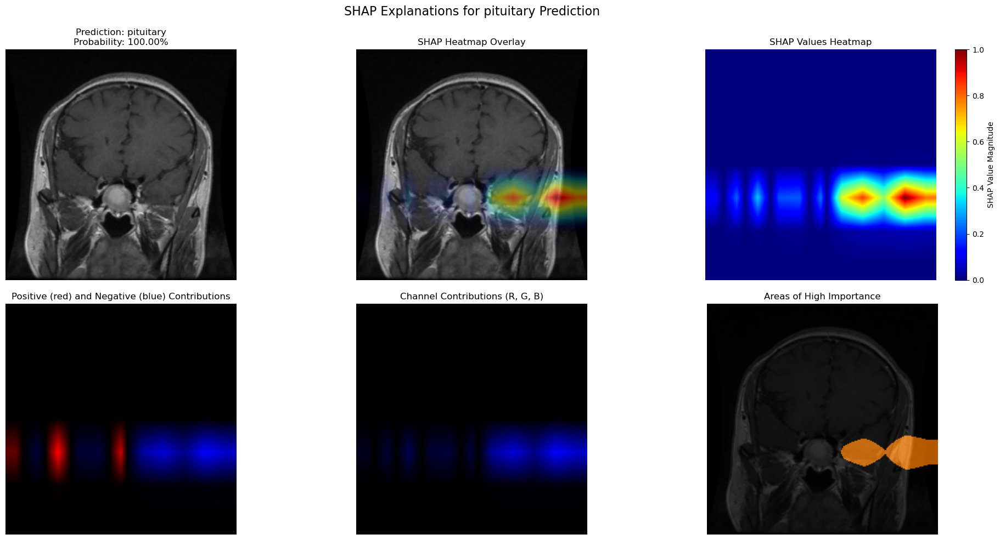

<Figure size 1000x600 with 0 Axes>

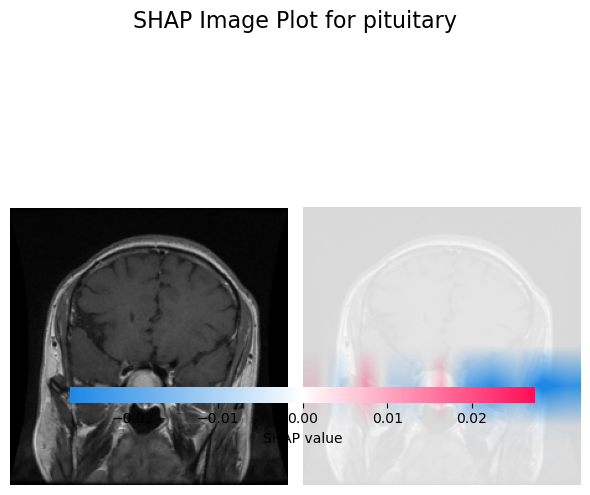

SHAP generation time: 62.7244 seconds


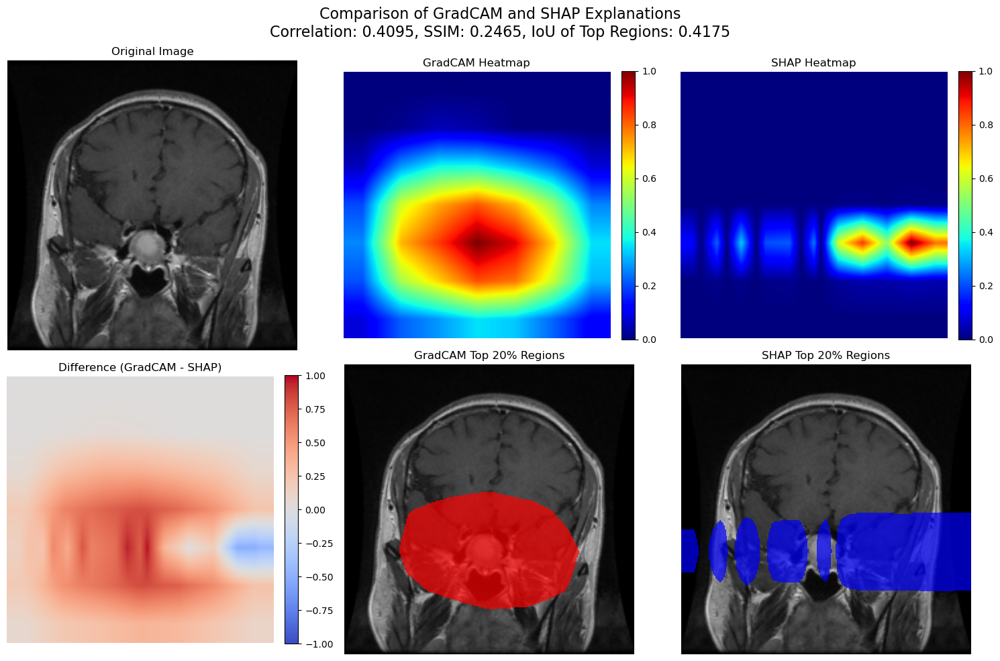


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.4095
SSIM between heatmaps: 0.2465
IoU of top 20% regions: 0.4175
GradCAM execution time: 0.1993 seconds
SHAP execution time: 62.7244 seconds

Diagnosis Results:
Classification: bone fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 100.00%
bone not fractured: 0.00%


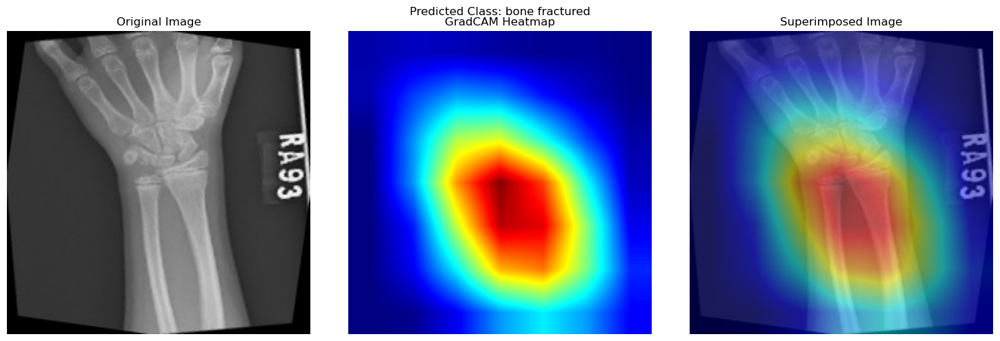

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


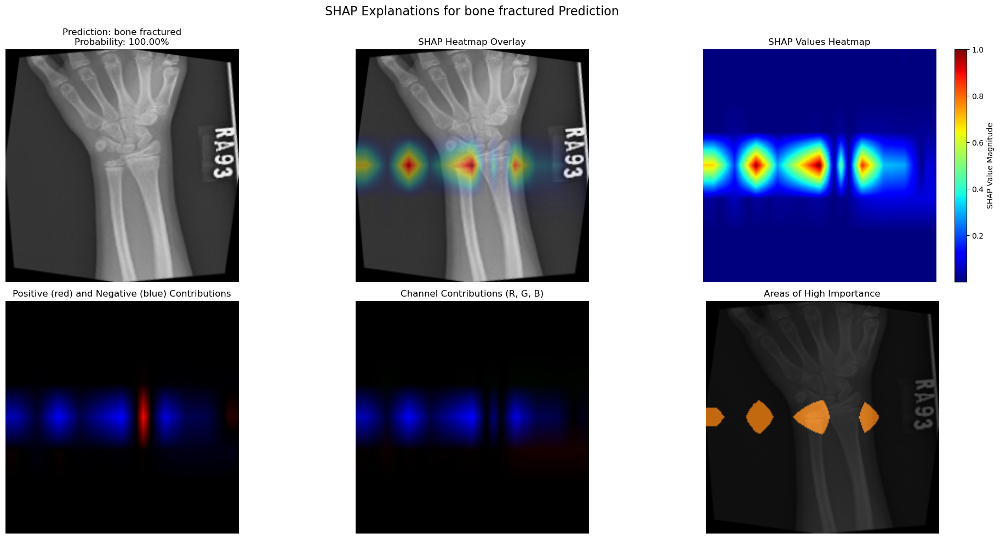

<Figure size 1000x600 with 0 Axes>

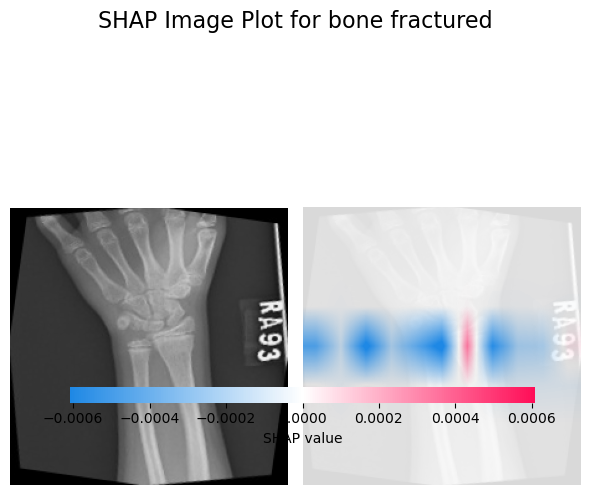


Diagnosis Results:
Classification: bone fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 100.00%
bone not fractured: 0.00%

=== Comparing Explainability Methods for bone fractured.jpg ===
Predicted class: bone fractured (confidence: 100.00%)

Generating GradCAM...


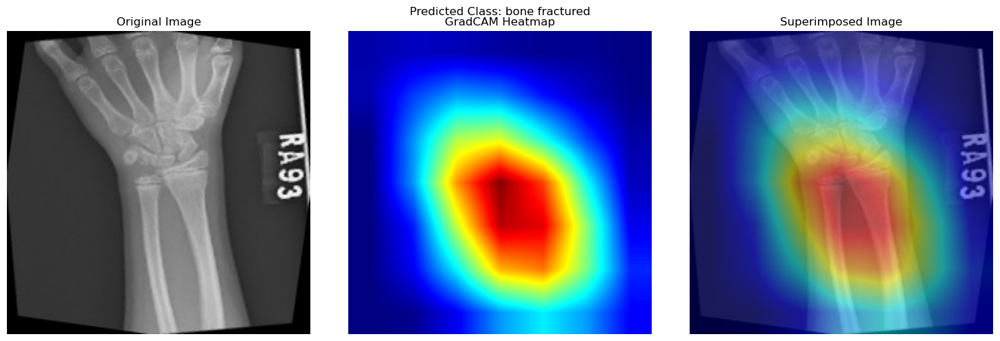

GradCAM generation time: 0.1781 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


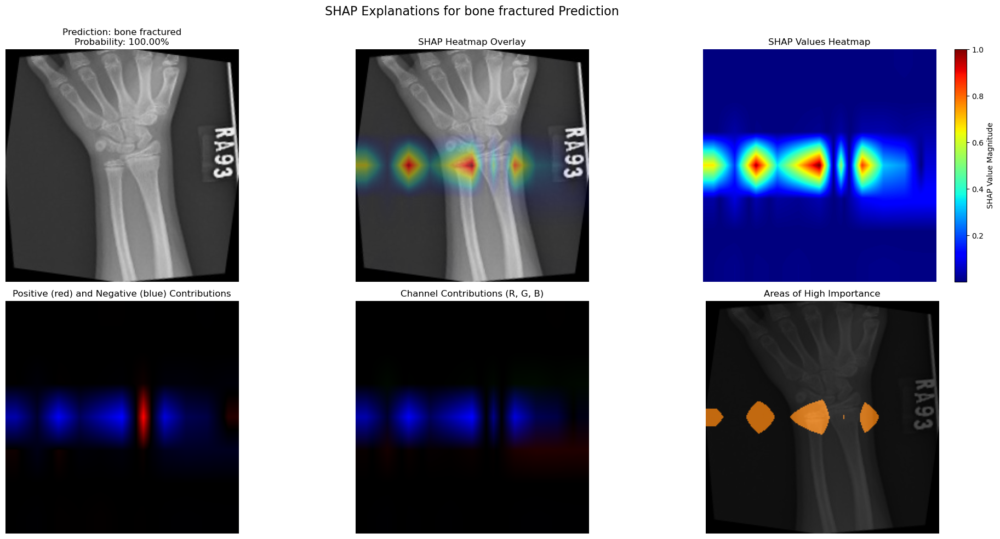

<Figure size 1000x600 with 0 Axes>

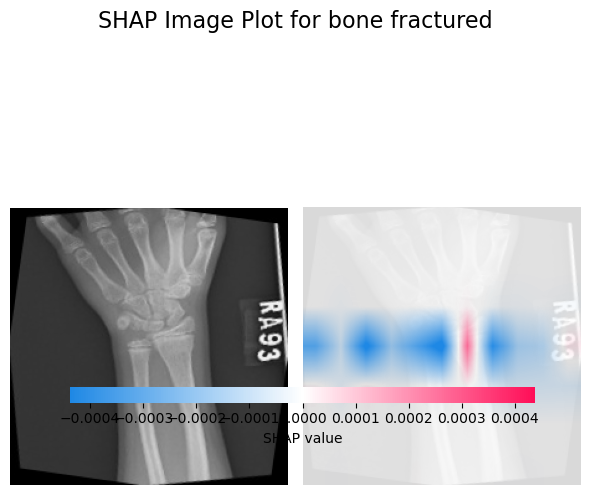

SHAP generation time: 62.1939 seconds


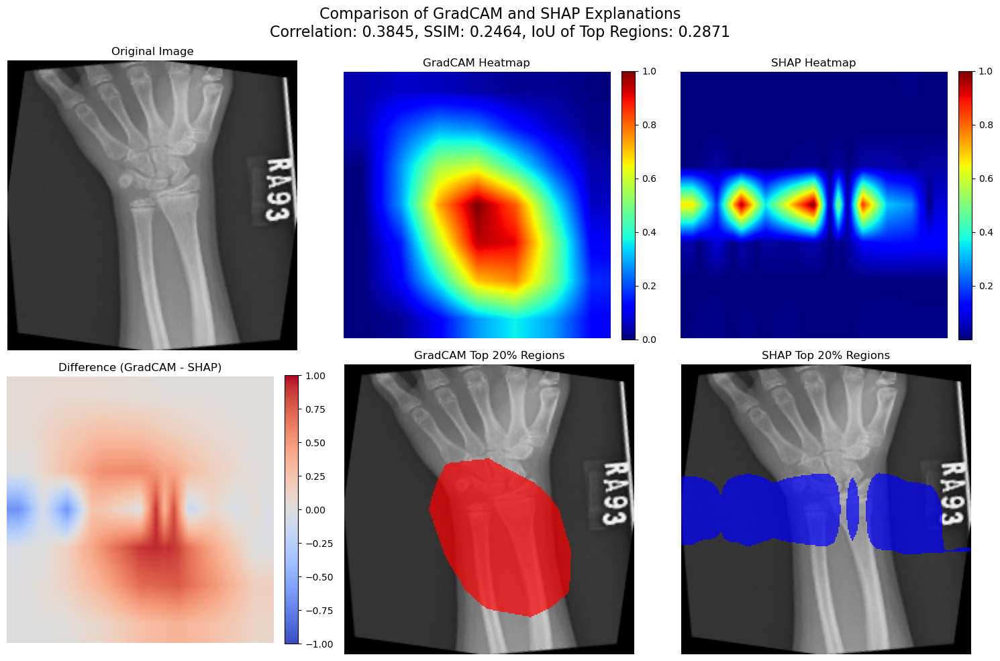


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.3845
SSIM between heatmaps: 0.2464
IoU of top 20% regions: 0.2871
GradCAM execution time: 0.1781 seconds
SHAP execution time: 62.1939 seconds

Diagnosis Results:
Classification: healthy brain
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 100.00%
glioma: 0.00%
meningioma: 0.00%


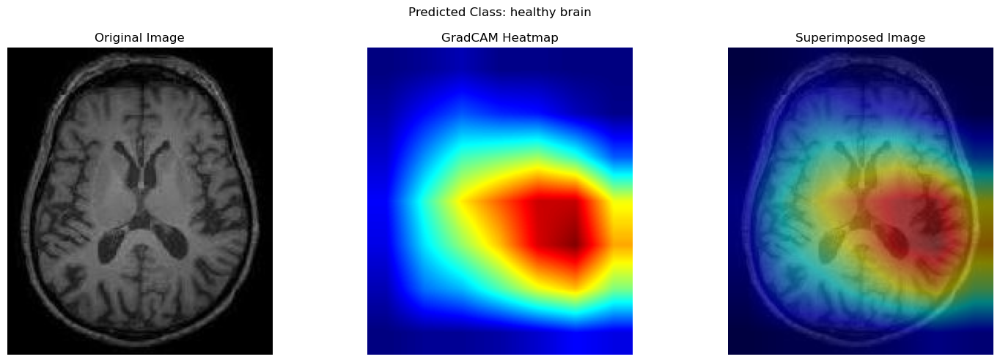

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


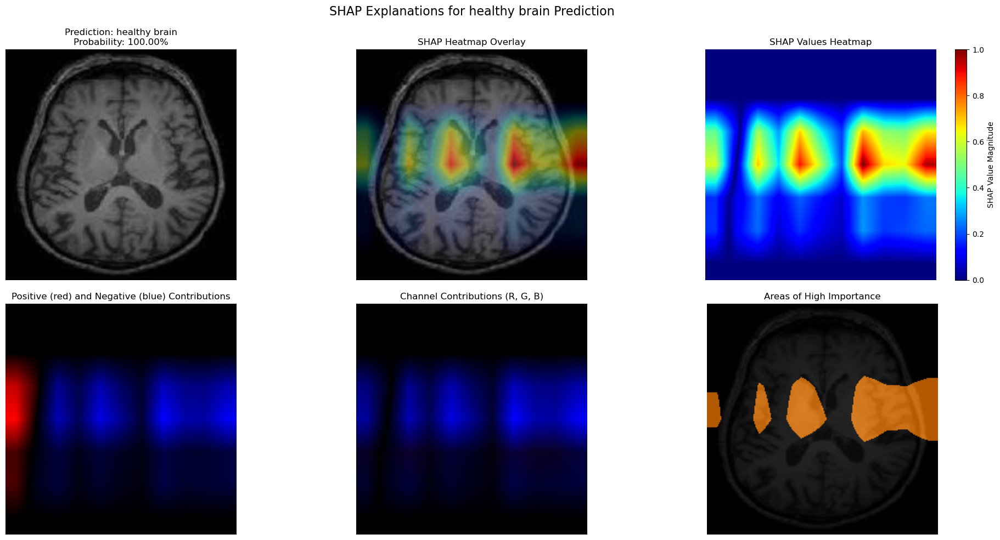

<Figure size 1000x600 with 0 Axes>

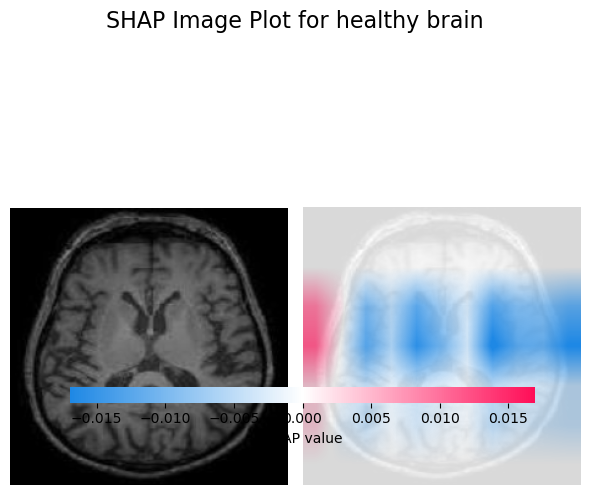


Diagnosis Results:
Classification: healthy brain
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 100.00%
glioma: 0.00%
meningioma: 0.00%

=== Comparing Explainability Methods for healthy brain.jpg ===
Predicted class: healthy brain (confidence: 100.00%)

Generating GradCAM...


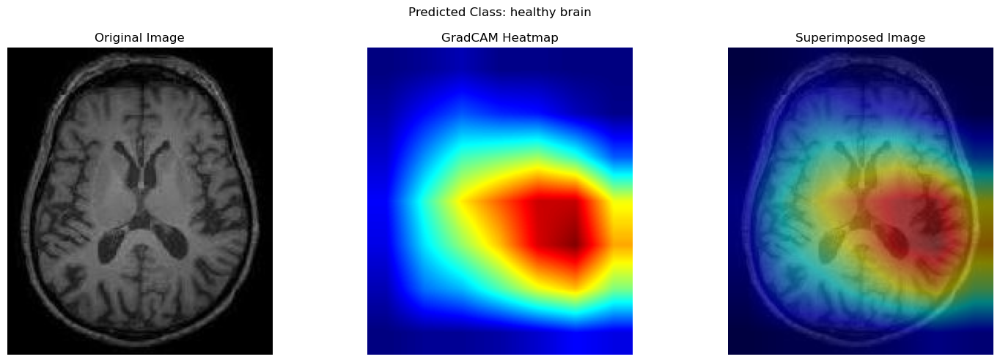

GradCAM generation time: 0.2982 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


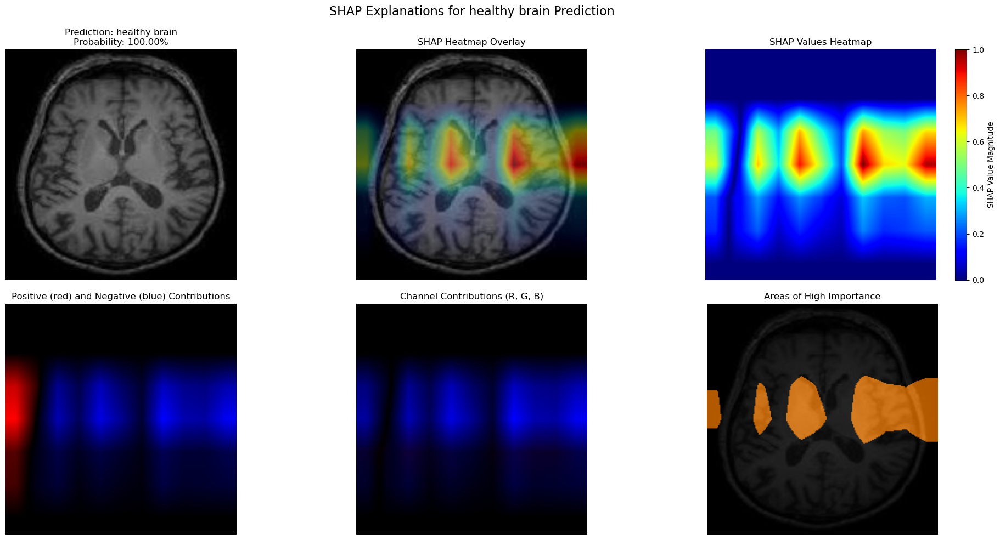

<Figure size 1000x600 with 0 Axes>

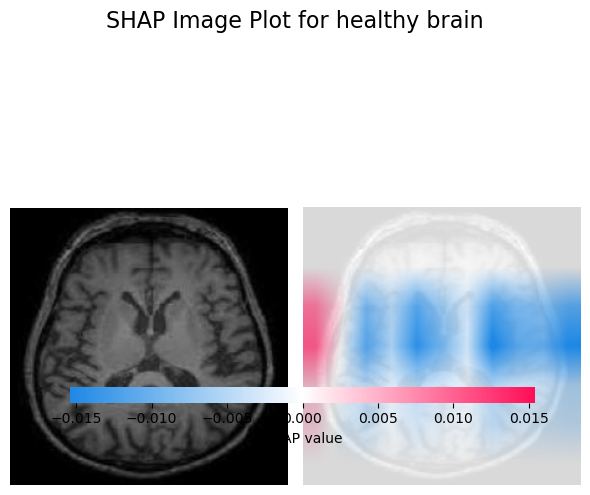

SHAP generation time: 64.2530 seconds


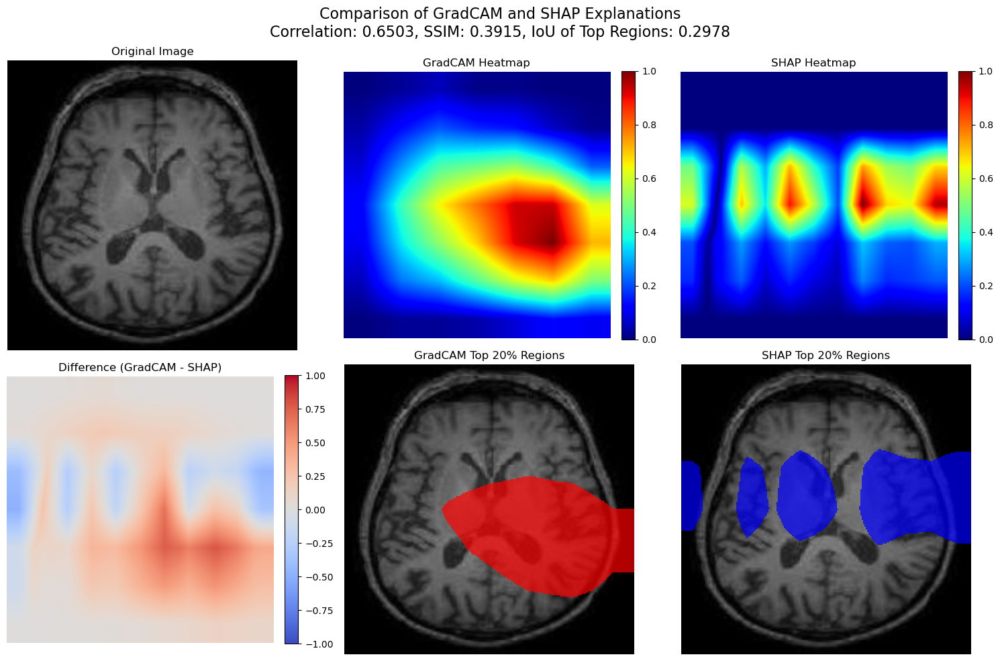


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.6503
SSIM between heatmaps: 0.3915
IoU of top 20% regions: 0.2978
GradCAM execution time: 0.2982 seconds
SHAP execution time: 64.2530 seconds

Diagnosis Results:
Classification: adenocarcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 100.00%
benign: 0.00%
squamous cell carcinoma: 0.00%


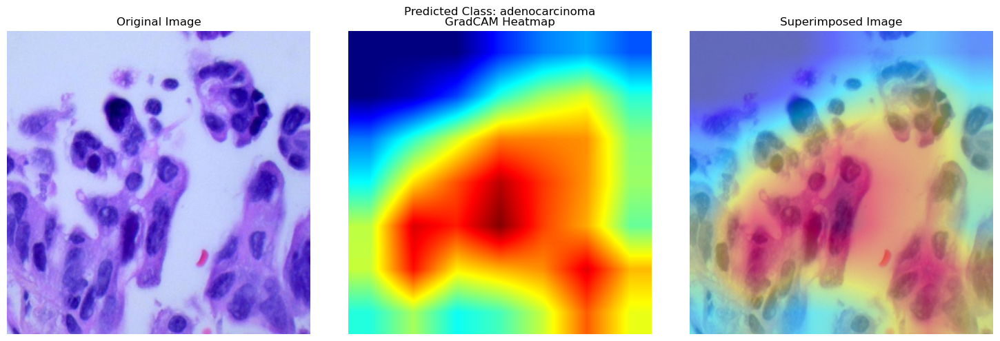

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


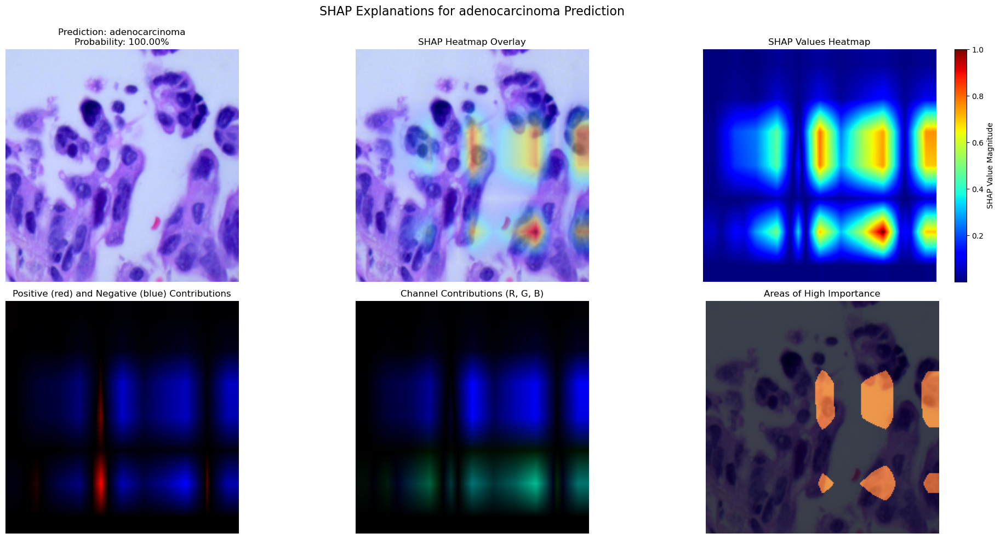

<Figure size 1000x600 with 0 Axes>

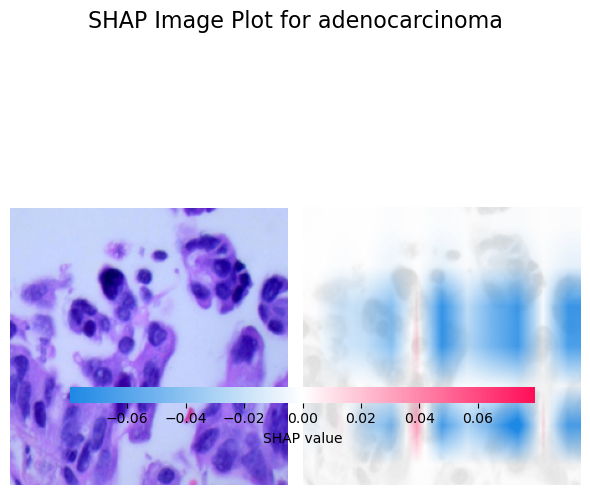


Diagnosis Results:
Classification: adenocarcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 100.00%
benign: 0.00%
squamous cell carcinoma: 0.00%

=== Comparing Explainability Methods for adenocarcinoma.jpg ===
Predicted class: adenocarcinoma (confidence: 100.00%)

Generating GradCAM...


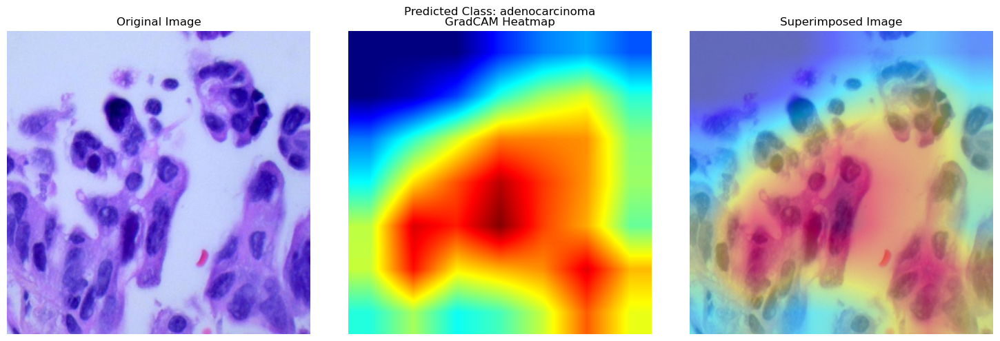

GradCAM generation time: 0.3107 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


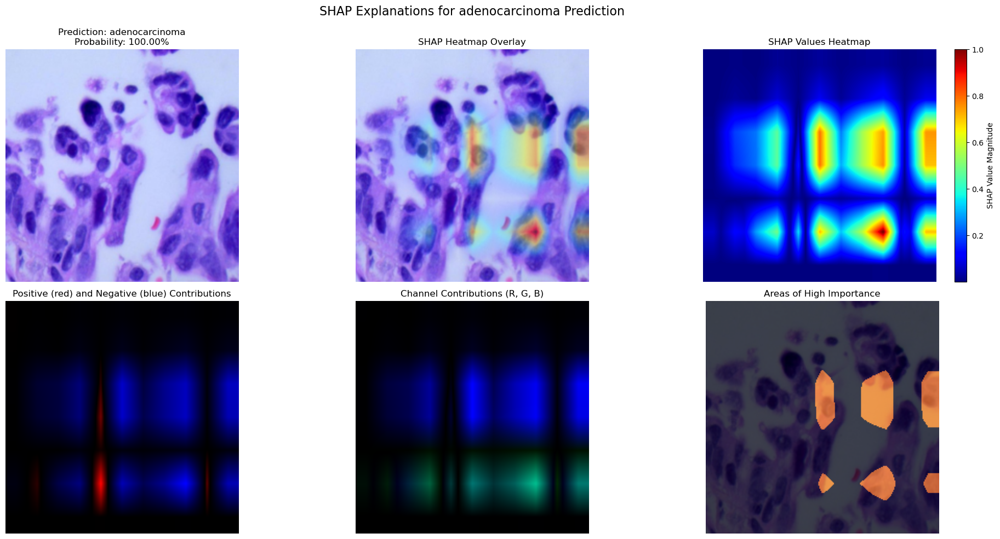

<Figure size 1000x600 with 0 Axes>

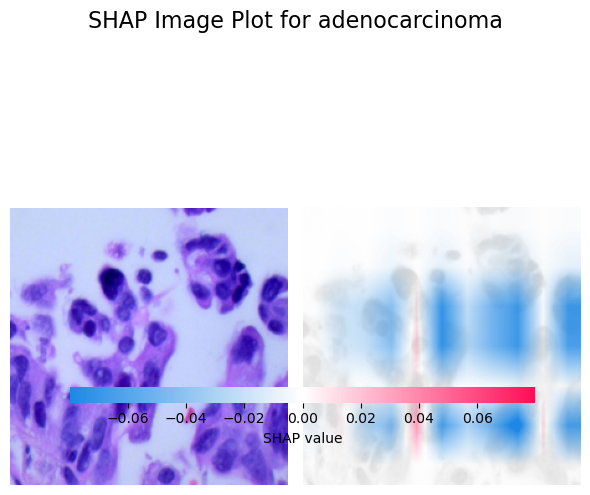

SHAP generation time: 63.6757 seconds


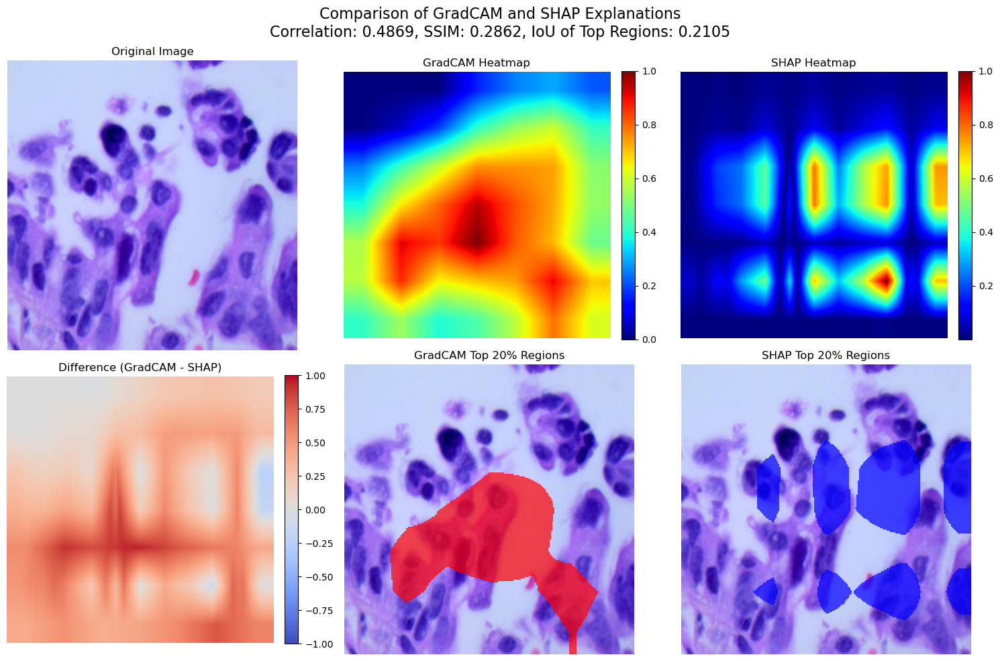


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.4869
SSIM between heatmaps: 0.2862
IoU of top 20% regions: 0.2105
GradCAM execution time: 0.3107 seconds
SHAP execution time: 63.6757 seconds

Diagnosis Results:
Classification: glioma
Confidence: 92.53%

Class Probabilities:
pituitary: 7.38%
healthy brain: 0.00%
glioma: 92.53%
meningioma: 0.09%


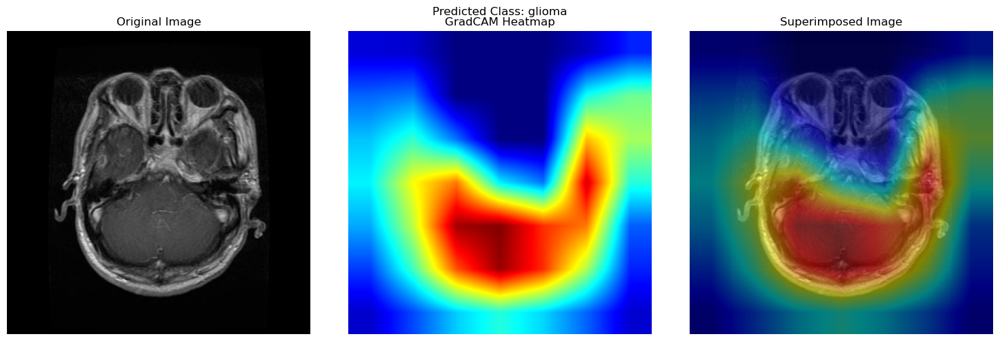

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


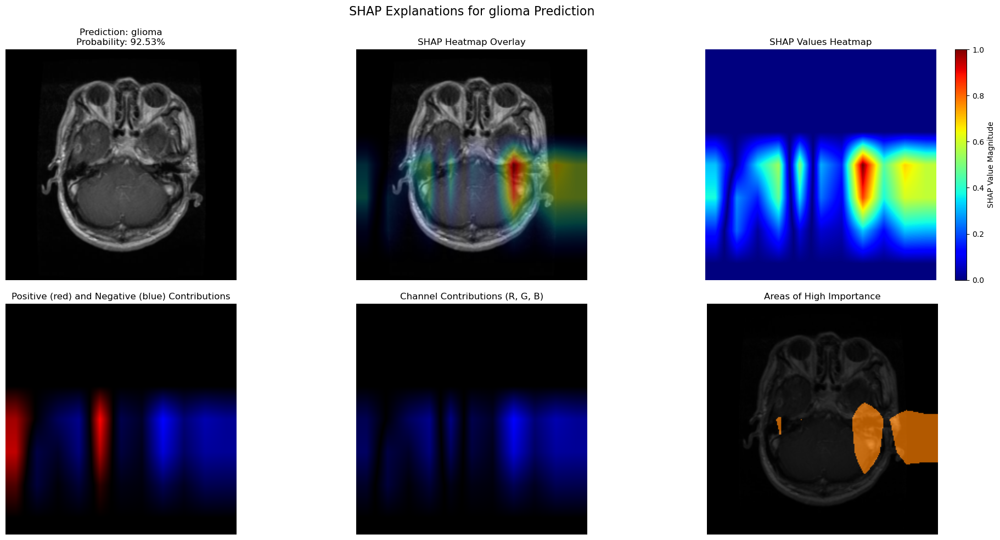

<Figure size 1000x600 with 0 Axes>

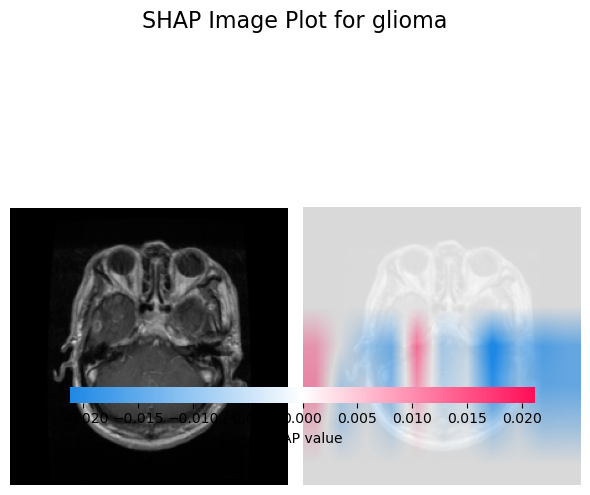


Diagnosis Results:
Classification: glioma
Confidence: 92.53%

Class Probabilities:
pituitary: 7.38%
healthy brain: 0.00%
glioma: 92.53%
meningioma: 0.09%

=== Comparing Explainability Methods for glioma.jpg ===
Predicted class: glioma (confidence: 92.53%)

Generating GradCAM...


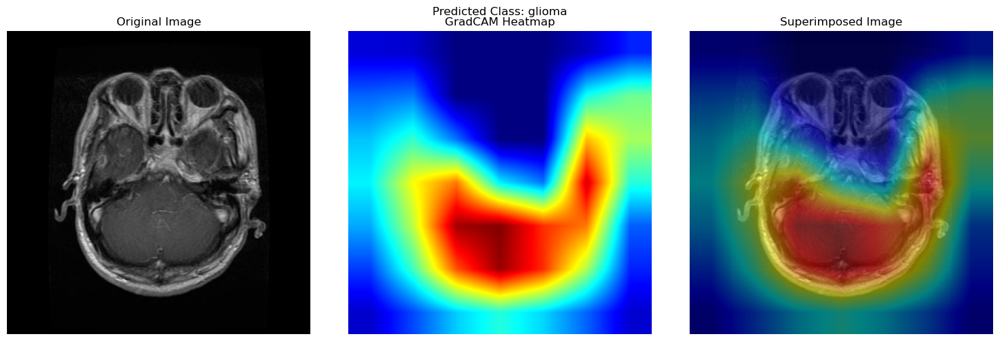

GradCAM generation time: 0.1906 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


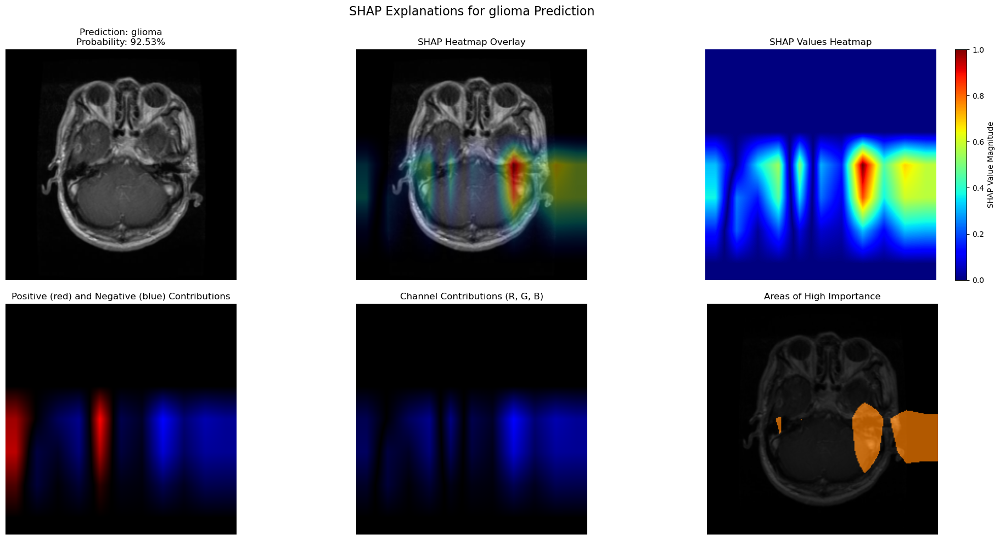

<Figure size 1000x600 with 0 Axes>

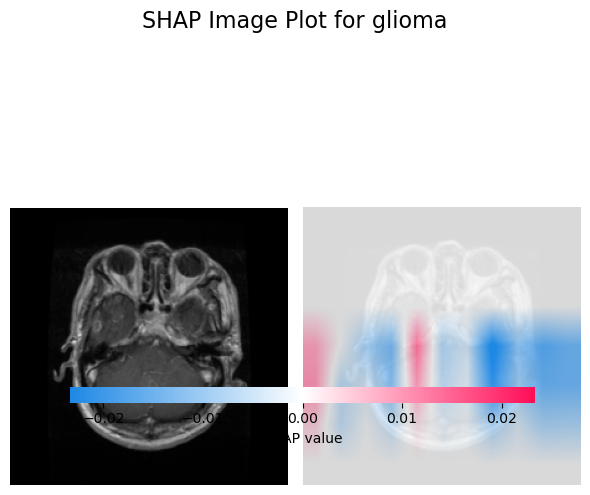

SHAP generation time: 64.7141 seconds


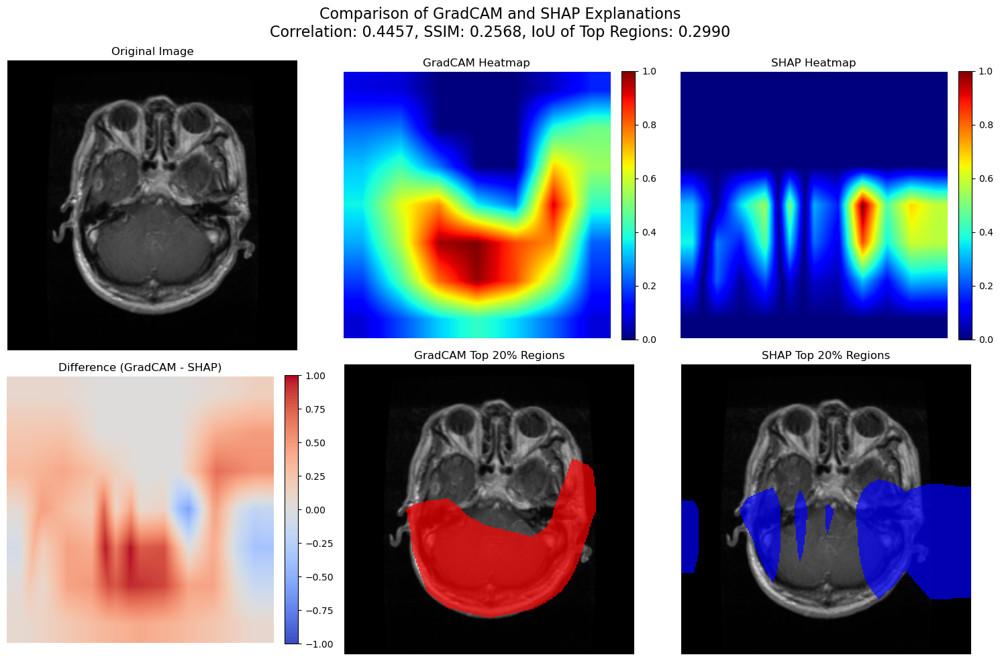


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.4457
SSIM between heatmaps: 0.2568
IoU of top 20% regions: 0.2990
GradCAM execution time: 0.1906 seconds
SHAP execution time: 64.7141 seconds

Diagnosis Results:
Classification: benign
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 0.00%
benign: 100.00%
squamous cell carcinoma: 0.00%


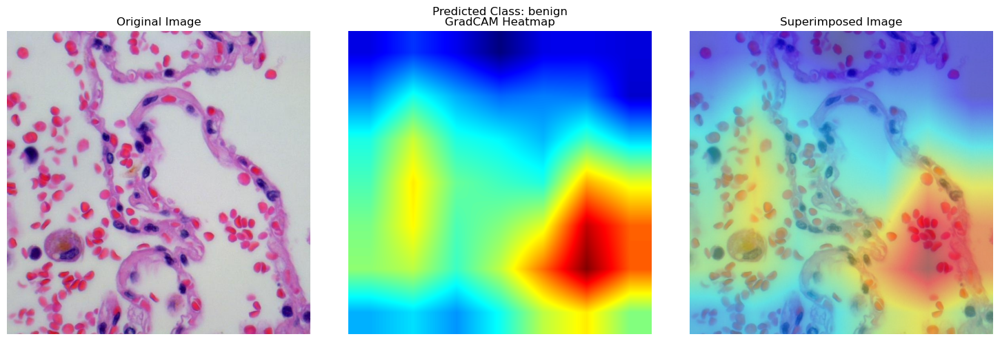

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


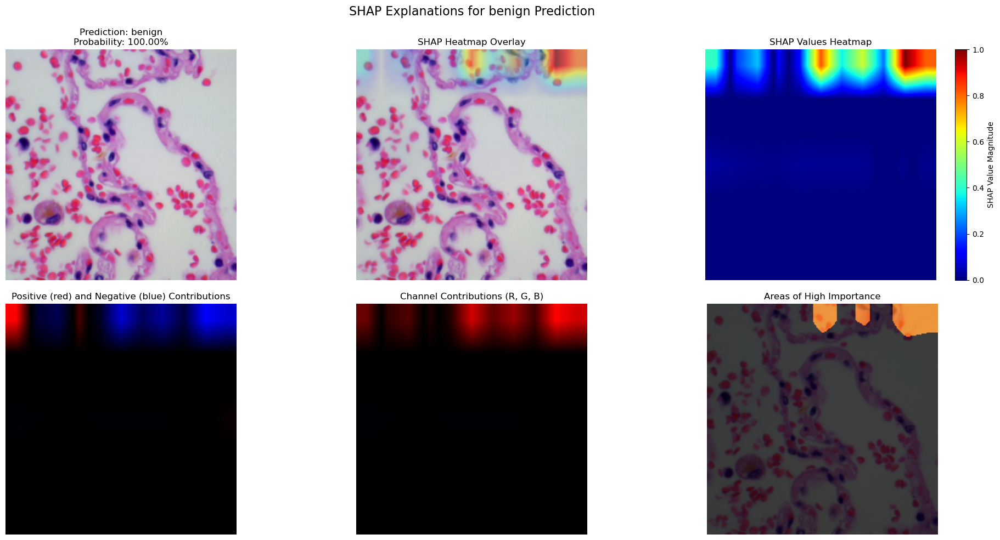

<Figure size 1000x600 with 0 Axes>

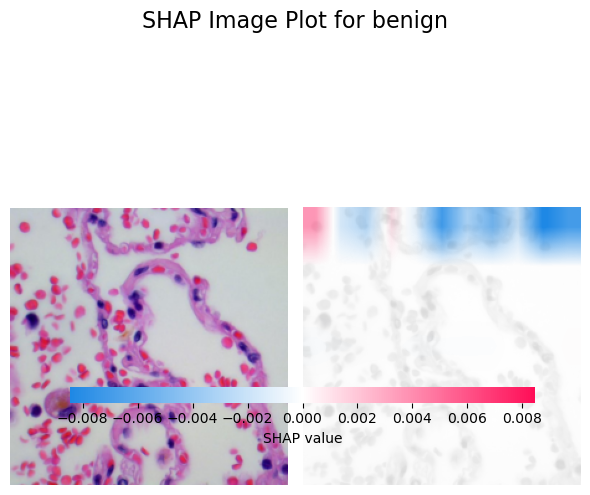


Diagnosis Results:
Classification: benign
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 0.00%
benign: 100.00%
squamous cell carcinoma: 0.00%

=== Comparing Explainability Methods for benign.jpg ===
Predicted class: benign (confidence: 100.00%)

Generating GradCAM...


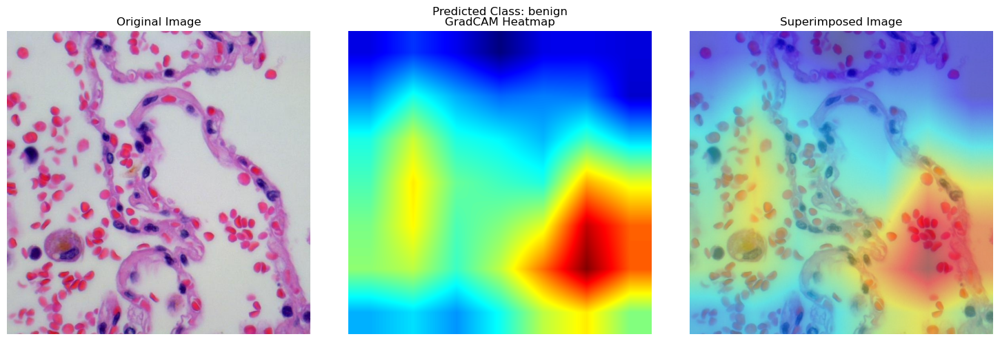

GradCAM generation time: 0.3205 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


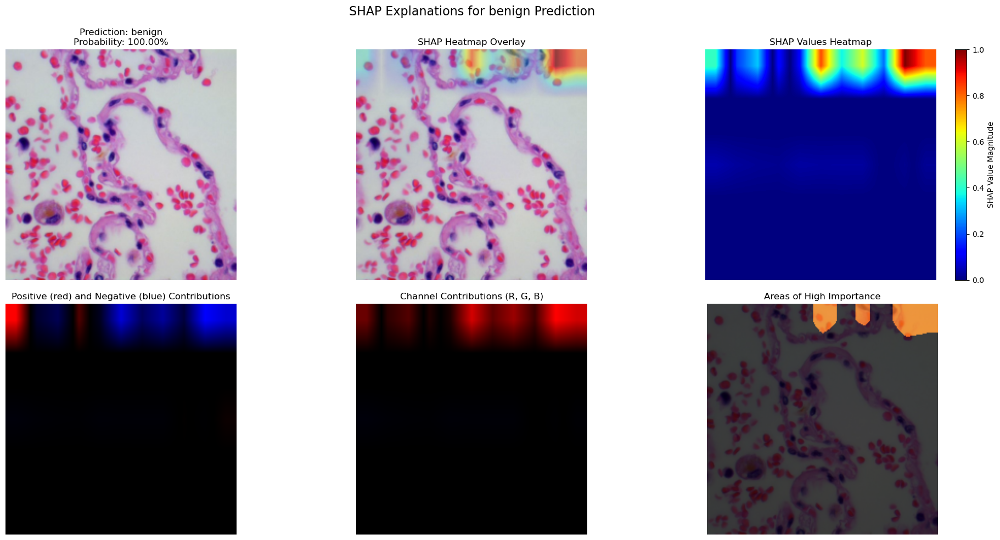

<Figure size 1000x600 with 0 Axes>

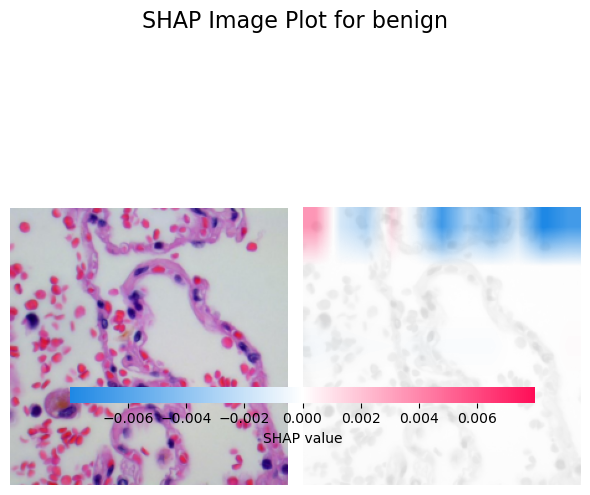

SHAP generation time: 63.2141 seconds


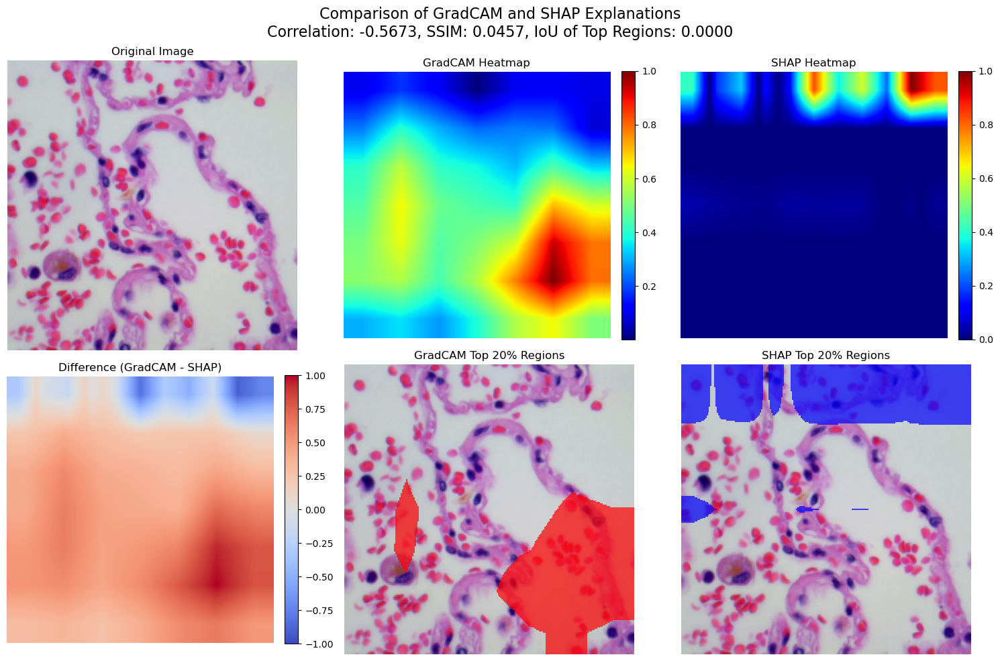


=== Explainability Methods Comparison ===
Correlation between heatmaps: -0.5673
SSIM between heatmaps: 0.0457
IoU of top 20% regions: 0.0000
GradCAM execution time: 0.3205 seconds
SHAP execution time: 63.2141 seconds

Diagnosis Results:
Classification: breast cancer positive
Confidence: 98.17%

Class Probabilities:
breast cancer negative: 1.82%
breast cancer positive: 98.17%


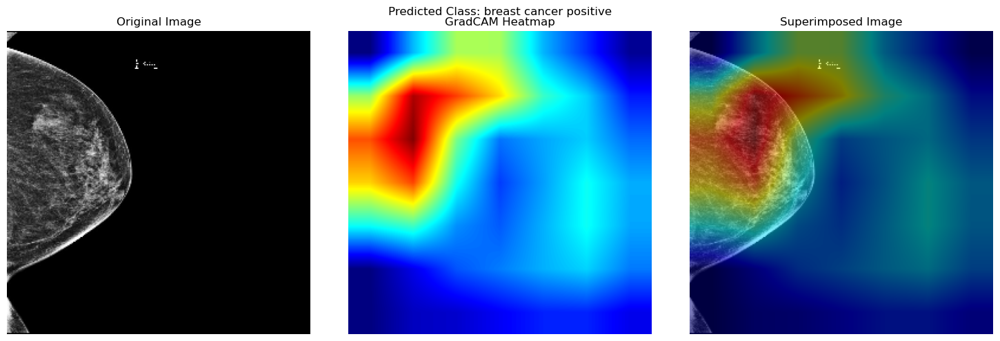

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


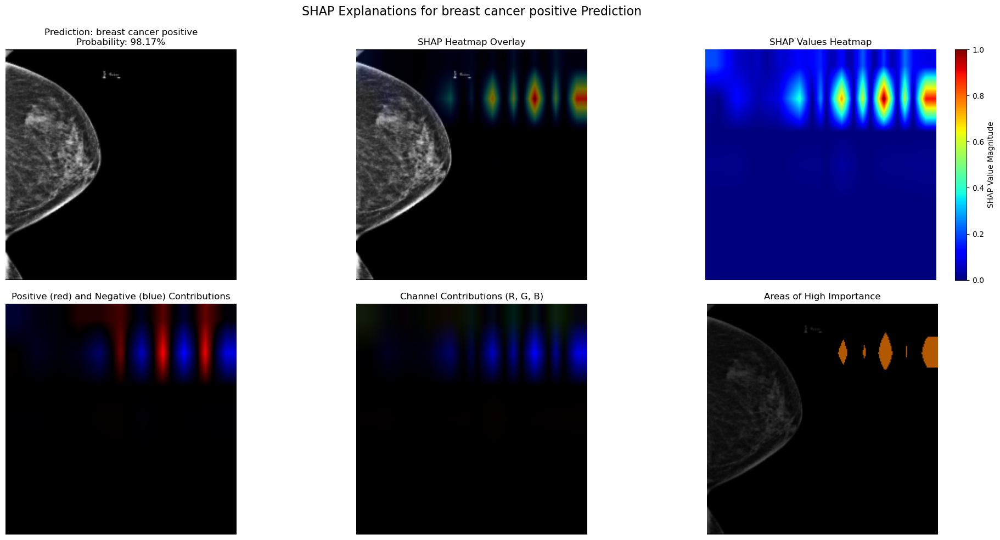

<Figure size 1000x600 with 0 Axes>

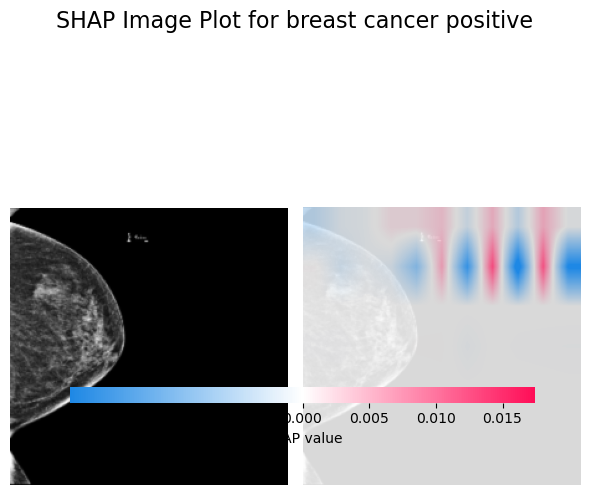


Diagnosis Results:
Classification: breast cancer positive
Confidence: 98.17%

Class Probabilities:
breast cancer negative: 1.82%
breast cancer positive: 98.17%

=== Comparing Explainability Methods for breast cancer positive.jpg ===
Predicted class: breast cancer positive (confidence: 98.17%)

Generating GradCAM...


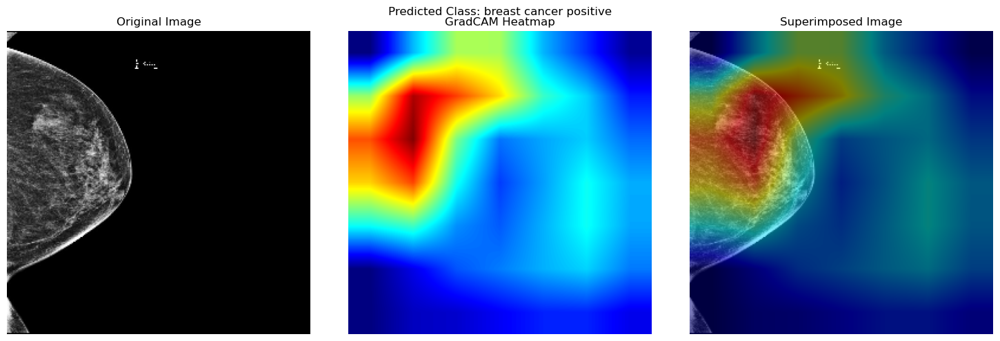

GradCAM generation time: 0.1882 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


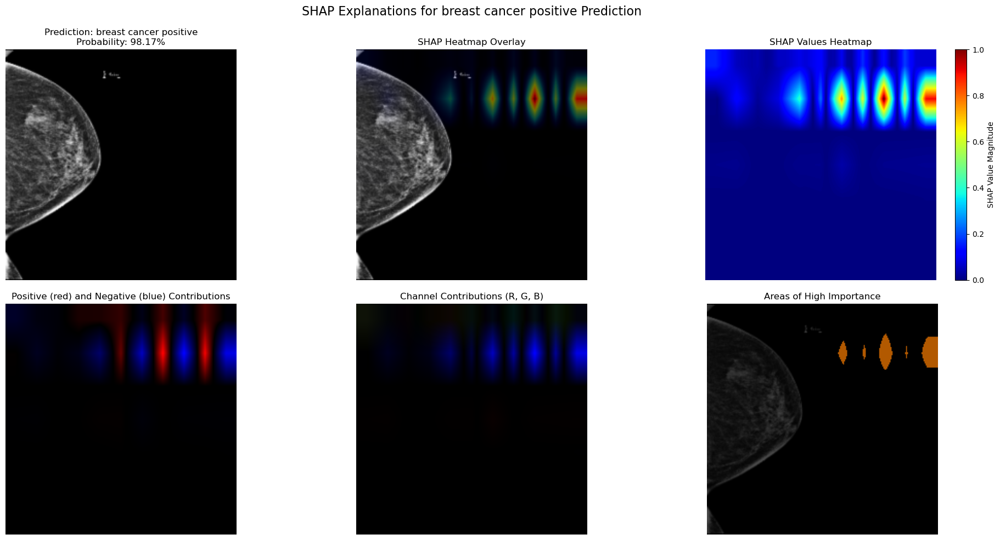

<Figure size 1000x600 with 0 Axes>

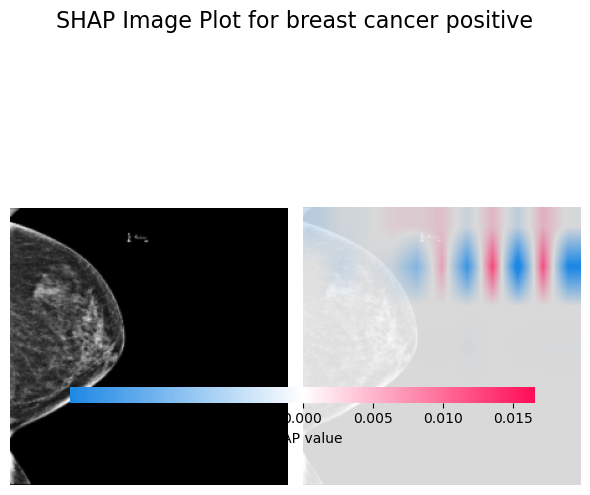

SHAP generation time: 63.7870 seconds


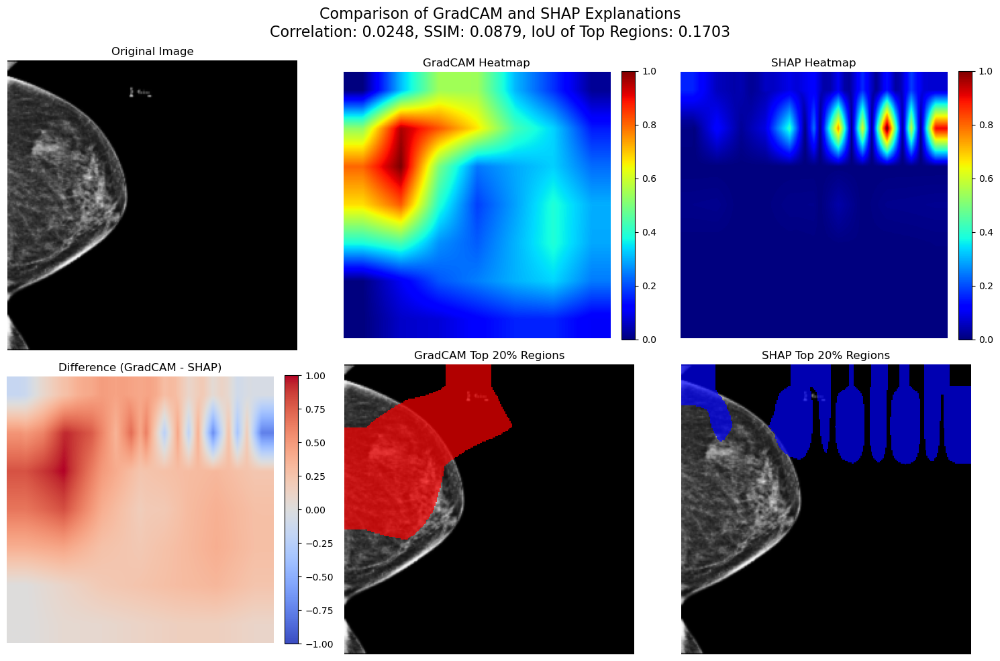


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.0248
SSIM between heatmaps: 0.0879
IoU of top 20% regions: 0.1703
GradCAM execution time: 0.1882 seconds
SHAP execution time: 63.7870 seconds

Diagnosis Results:
Classification: bone not fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 0.00%
bone not fractured: 100.00%


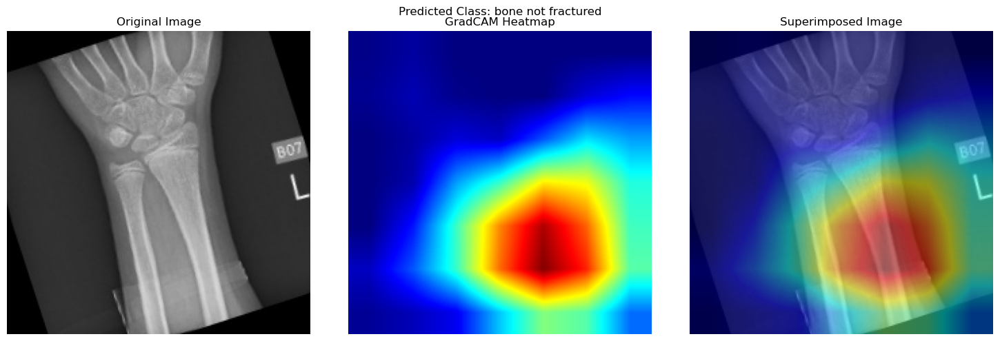

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


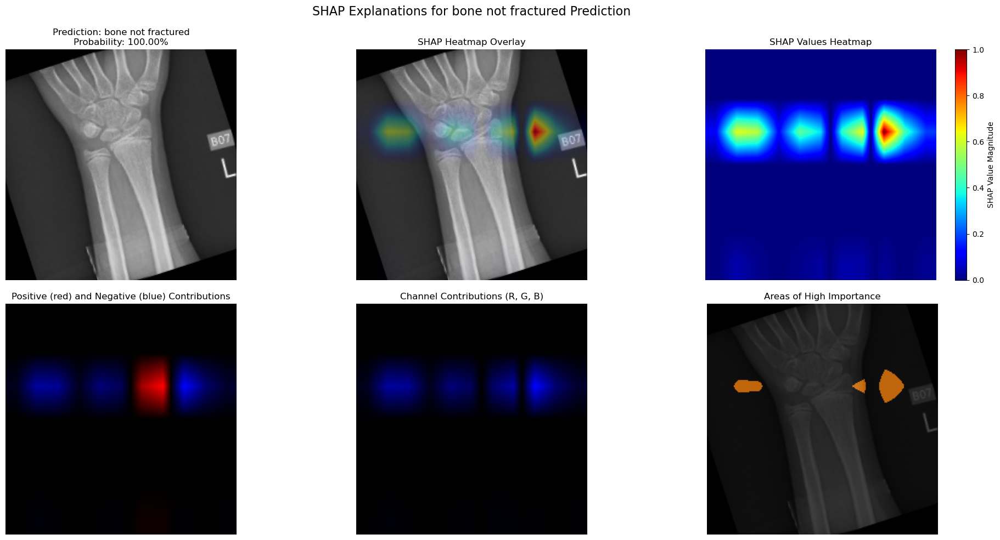

<Figure size 1000x600 with 0 Axes>

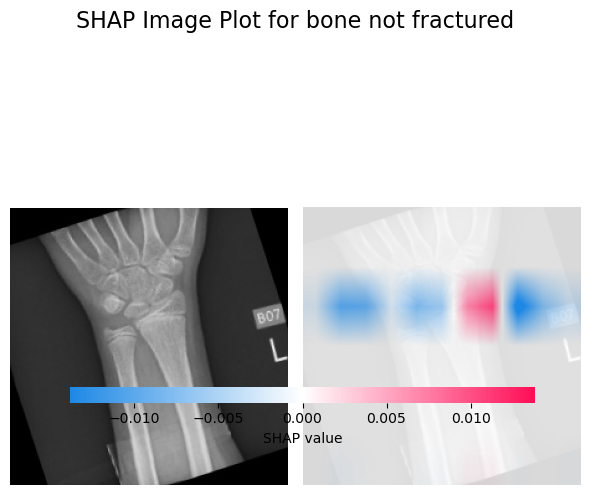


Diagnosis Results:
Classification: bone not fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 0.00%
bone not fractured: 100.00%

=== Comparing Explainability Methods for bone not fractured.jpg ===
Predicted class: bone not fractured (confidence: 100.00%)

Generating GradCAM...


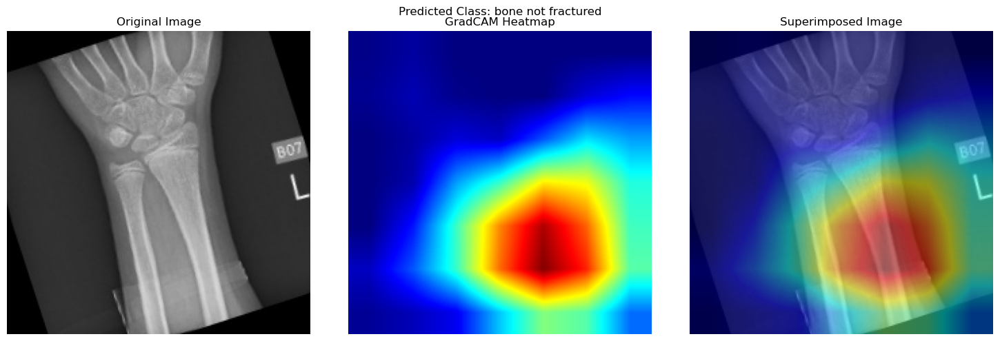

GradCAM generation time: 0.1831 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


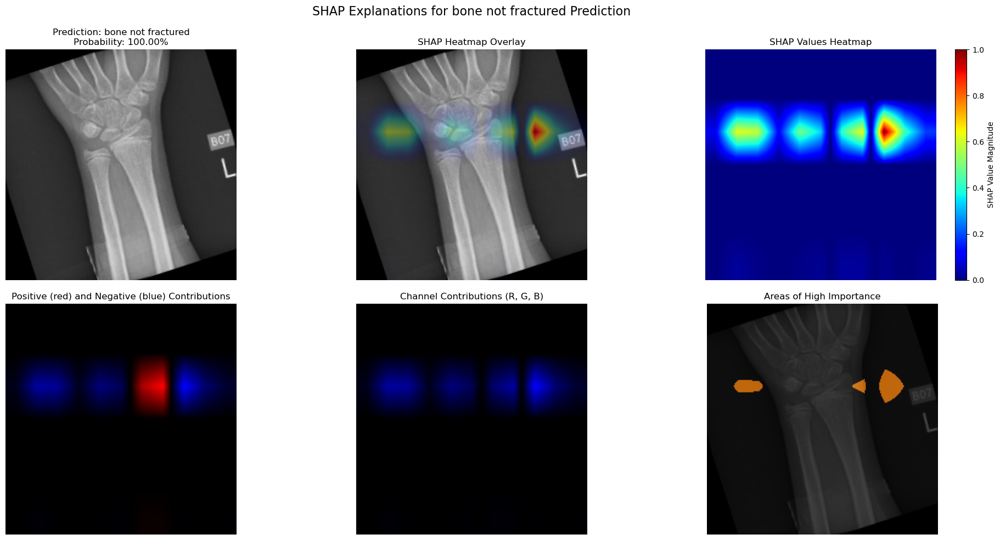

<Figure size 1000x600 with 0 Axes>

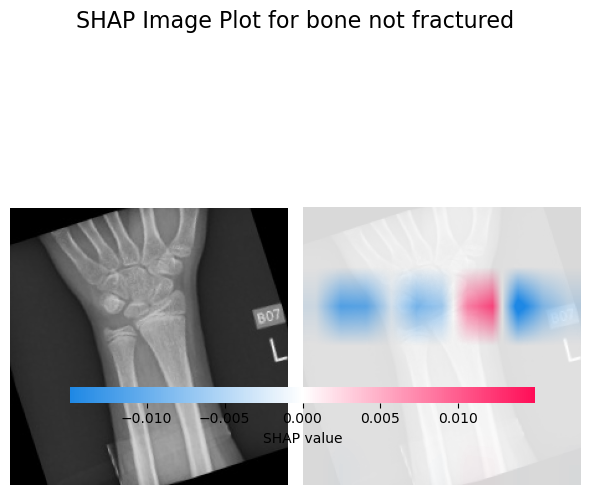

SHAP generation time: 63.1432 seconds


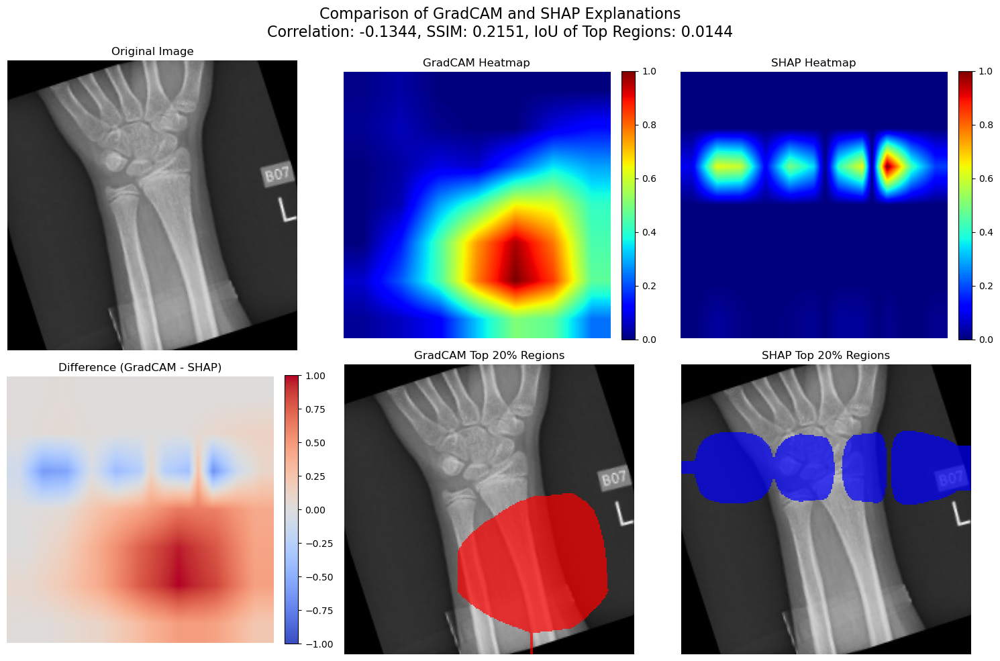


=== Explainability Methods Comparison ===
Correlation between heatmaps: -0.1344
SSIM between heatmaps: 0.2151
IoU of top 20% regions: 0.0144
GradCAM execution time: 0.1831 seconds
SHAP execution time: 63.1432 seconds

Diagnosis Results:
Classification: squamous cell carcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 0.00%
benign: 0.00%
squamous cell carcinoma: 100.00%


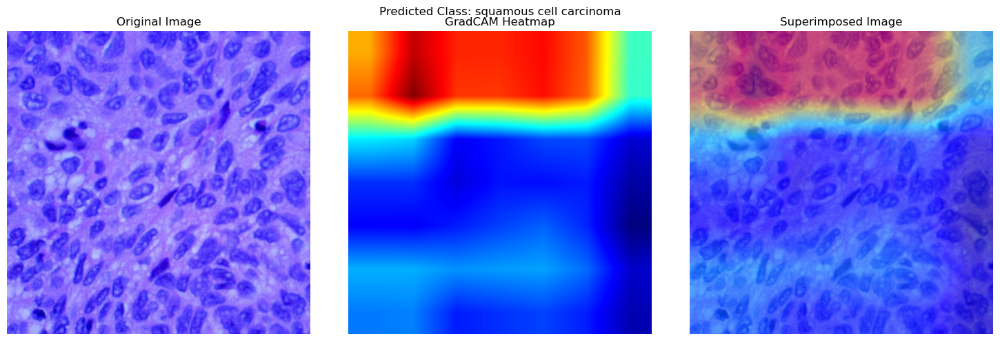

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


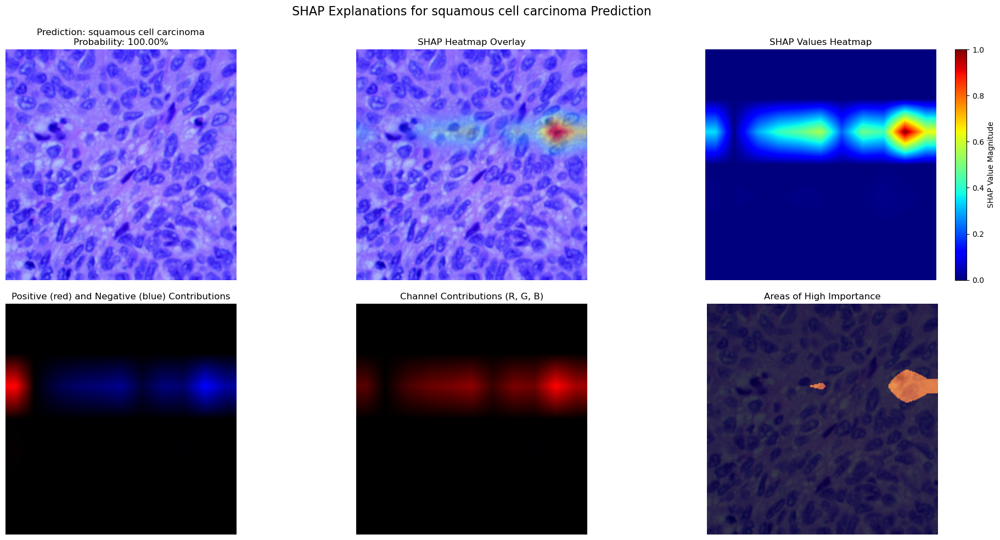

<Figure size 1000x600 with 0 Axes>

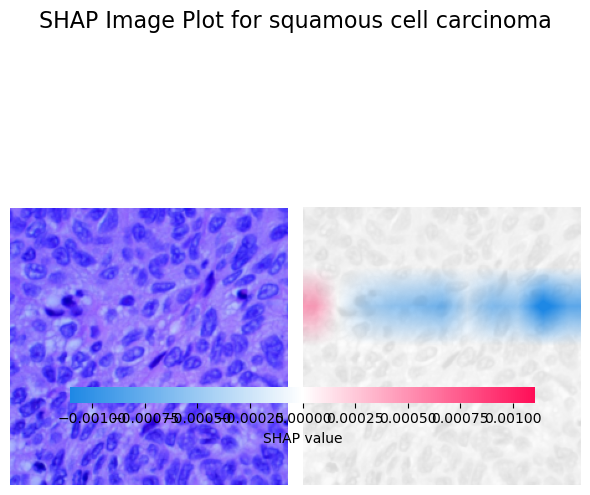


Diagnosis Results:
Classification: squamous cell carcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 0.00%
benign: 0.00%
squamous cell carcinoma: 100.00%

=== Comparing Explainability Methods for squamous cell carcinoma.jpg ===
Predicted class: squamous cell carcinoma (confidence: 100.00%)

Generating GradCAM...


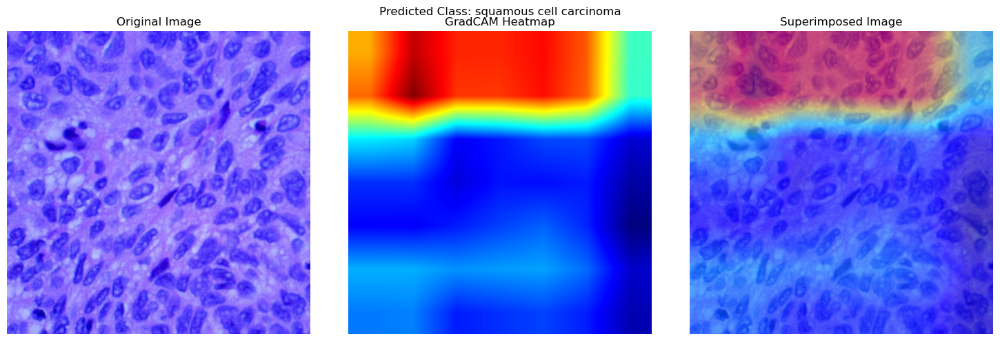

GradCAM generation time: 0.2990 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


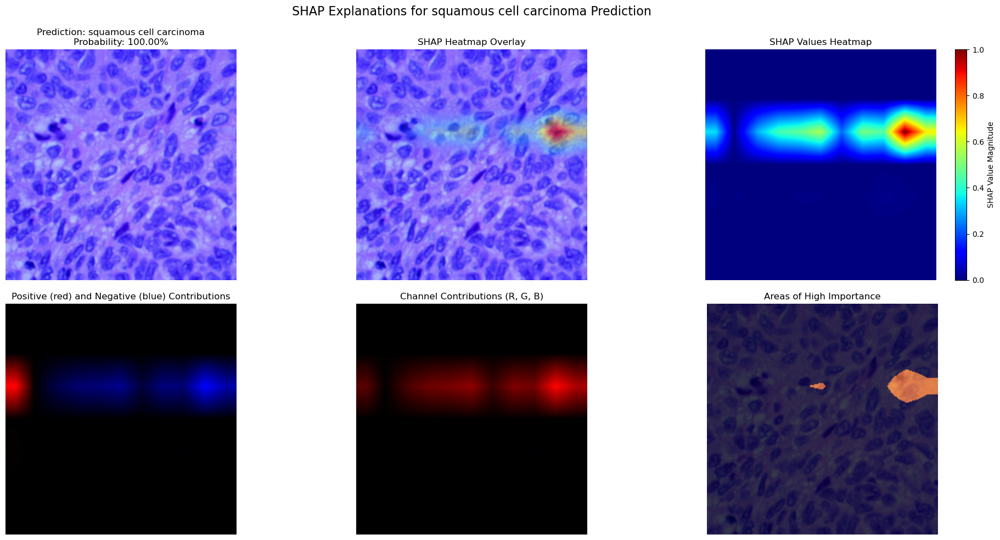

<Figure size 1000x600 with 0 Axes>

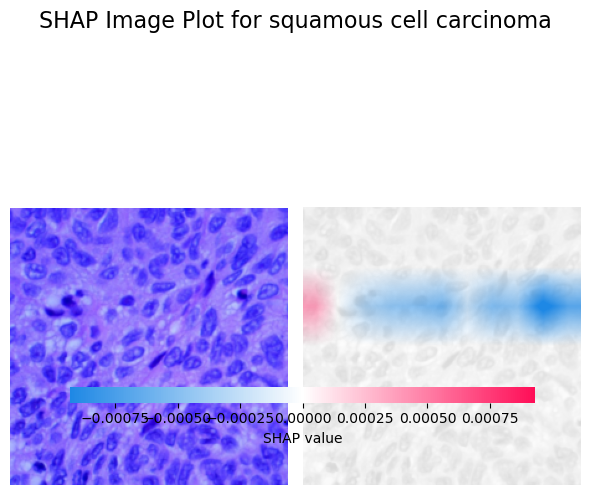

SHAP generation time: 63.9325 seconds


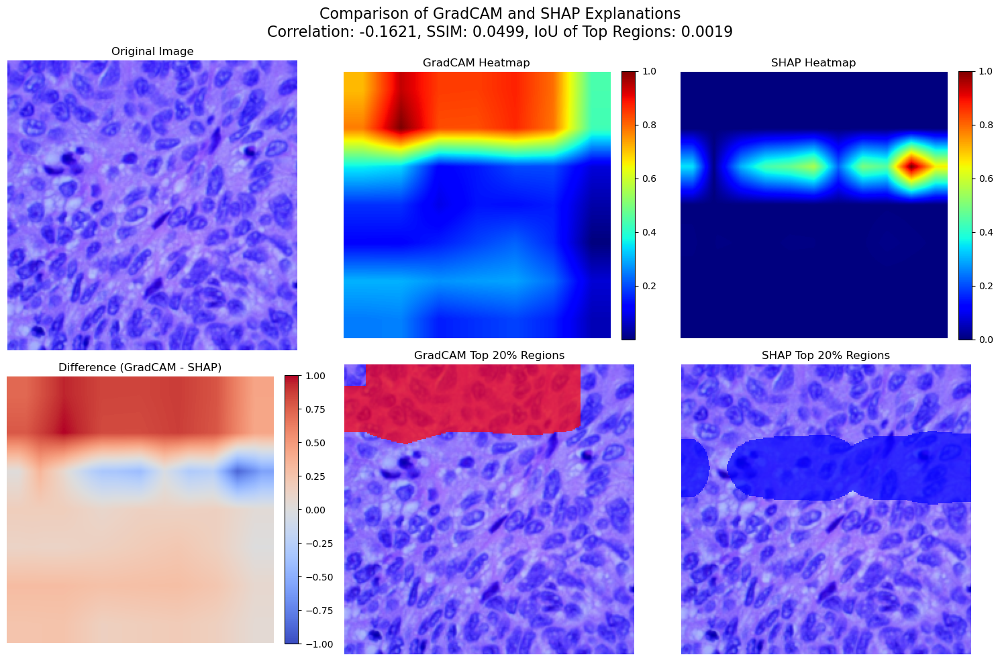


=== Explainability Methods Comparison ===
Correlation between heatmaps: -0.1621
SSIM between heatmaps: 0.0499
IoU of top 20% regions: 0.0019
GradCAM execution time: 0.2990 seconds
SHAP execution time: 63.9325 seconds

Diagnosis Results:
Classification: meningioma
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 100.00%


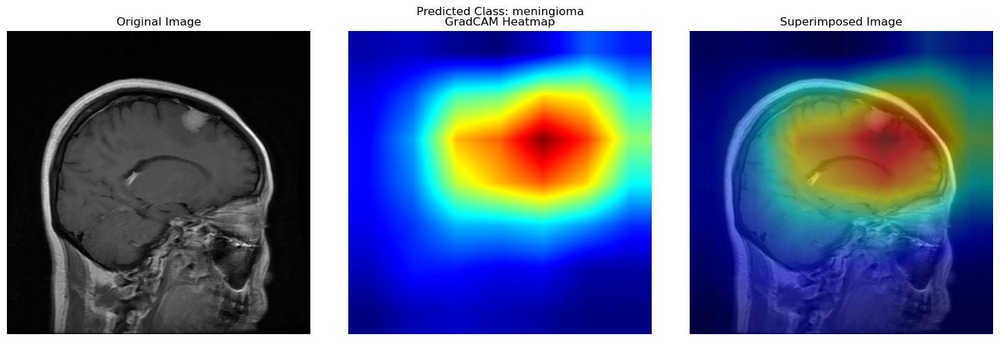

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


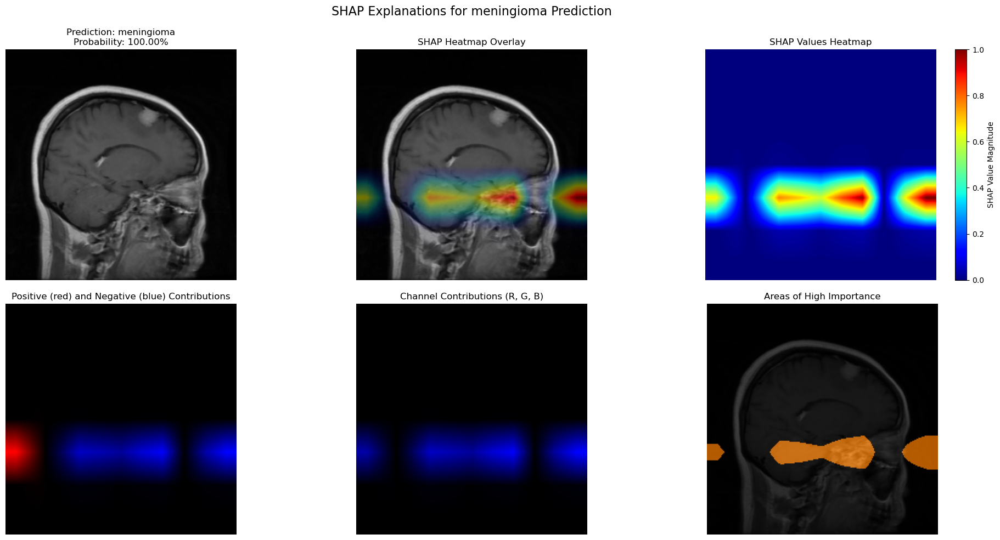

<Figure size 1000x600 with 0 Axes>

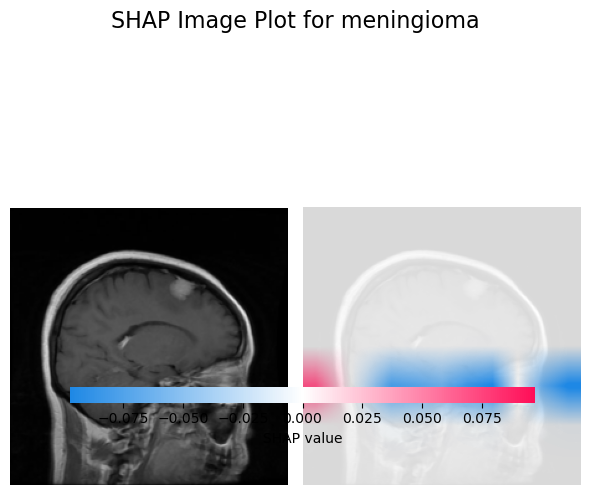


Diagnosis Results:
Classification: meningioma
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 100.00%

=== Comparing Explainability Methods for meningioma.jpg ===
Predicted class: meningioma (confidence: 100.00%)

Generating GradCAM...


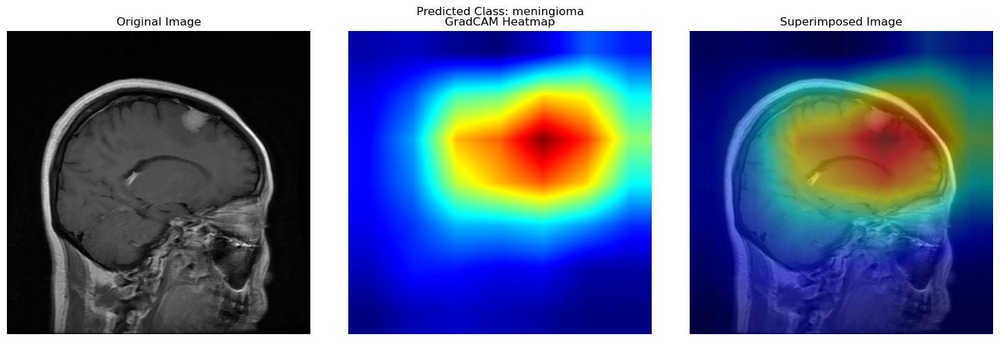

GradCAM generation time: 0.1976 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


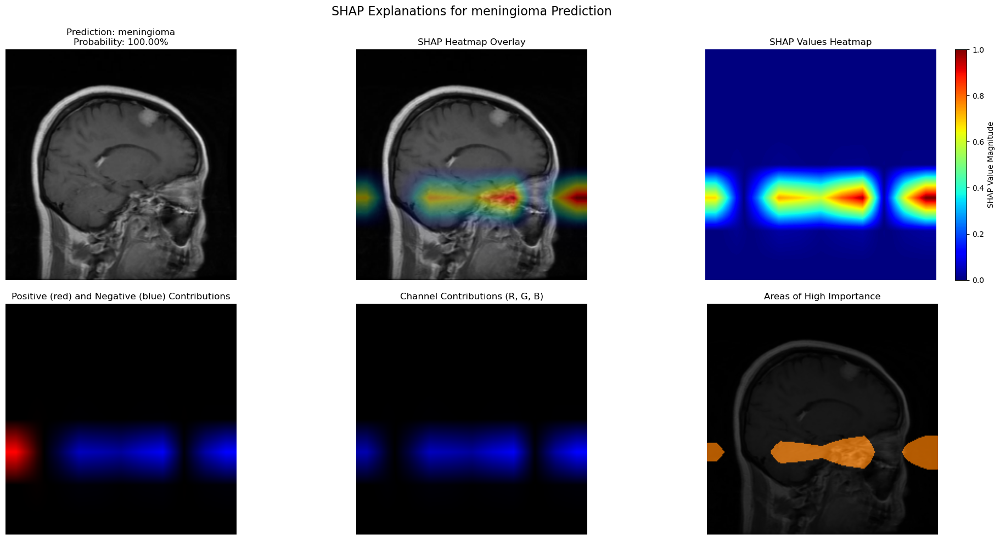

<Figure size 1000x600 with 0 Axes>

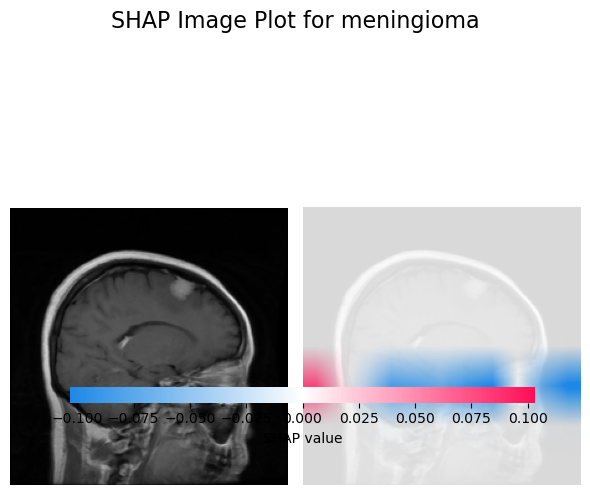

SHAP generation time: 64.3938 seconds


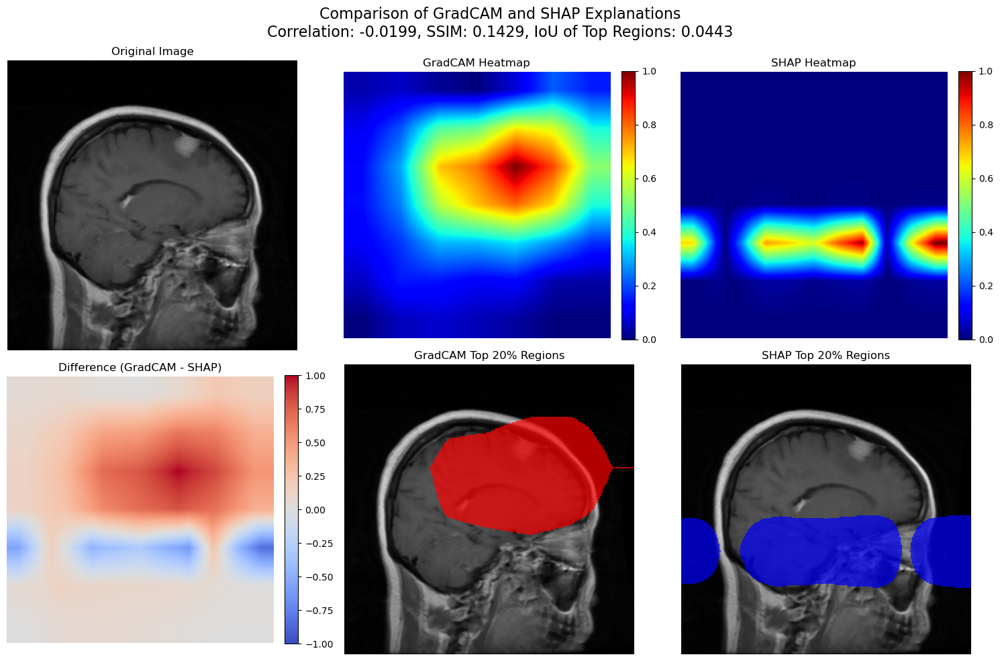


=== Explainability Methods Comparison ===
Correlation between heatmaps: -0.0199
SSIM between heatmaps: 0.1429
IoU of top 20% regions: 0.0443
GradCAM execution time: 0.1976 seconds
SHAP execution time: 64.3938 seconds

Diagnosis Results:
Classification: breast cancer negative
Confidence: 86.08%

Class Probabilities:
breast cancer negative: 86.08%
breast cancer positive: 13.92%


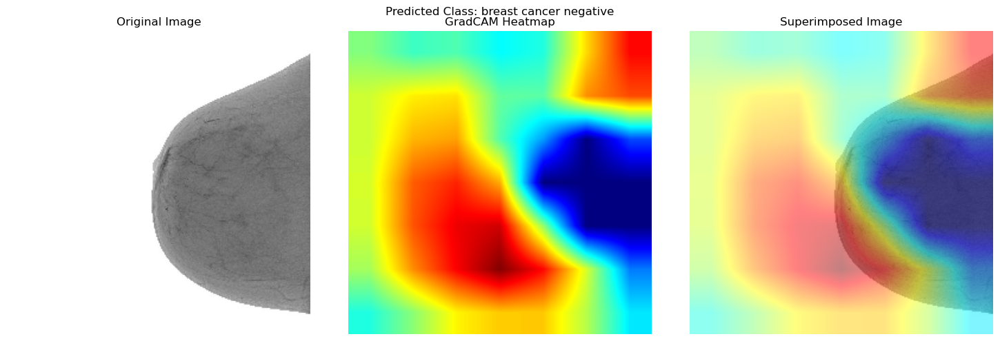

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


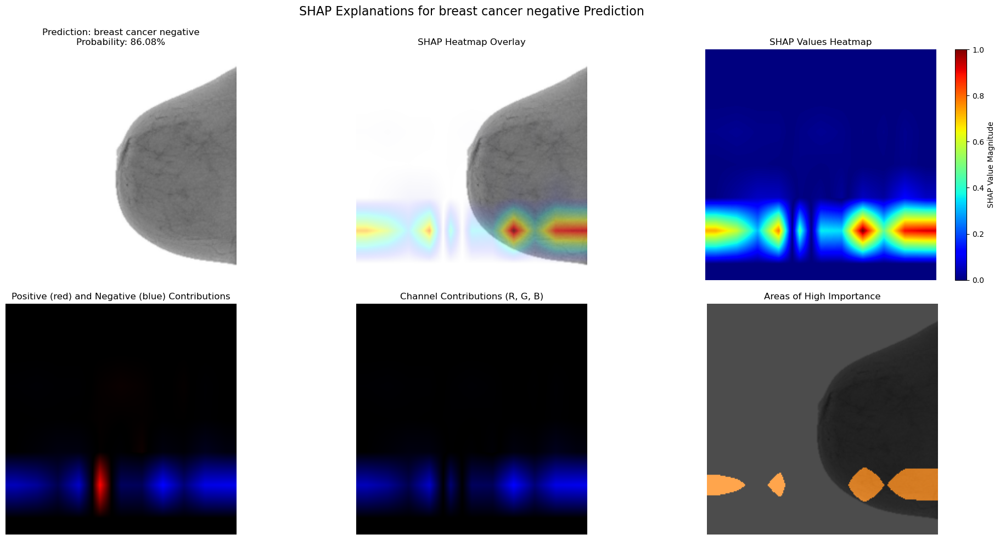

<Figure size 1000x600 with 0 Axes>

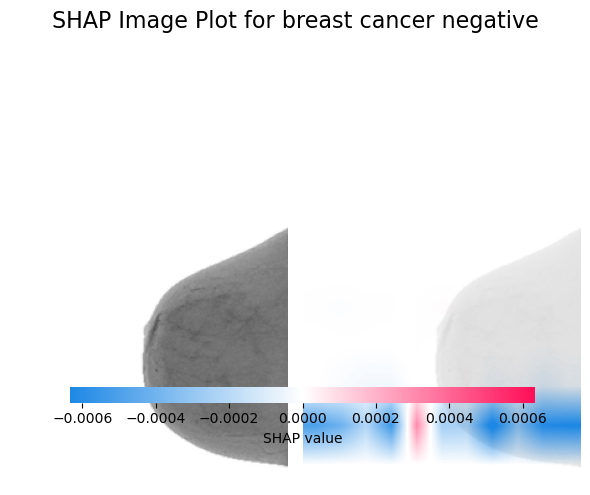


Diagnosis Results:
Classification: breast cancer negative
Confidence: 86.08%

Class Probabilities:
breast cancer negative: 86.08%
breast cancer positive: 13.92%

=== Comparing Explainability Methods for breast cancer negative.jpg ===
Predicted class: breast cancer negative (confidence: 86.08%)

Generating GradCAM...


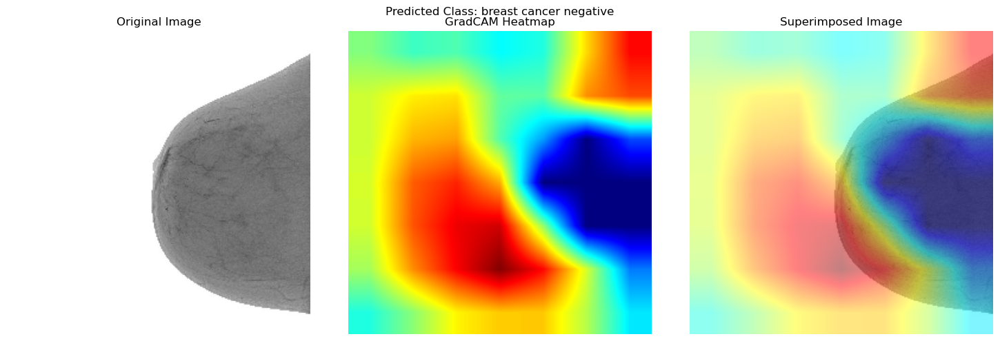

GradCAM generation time: 0.1965 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


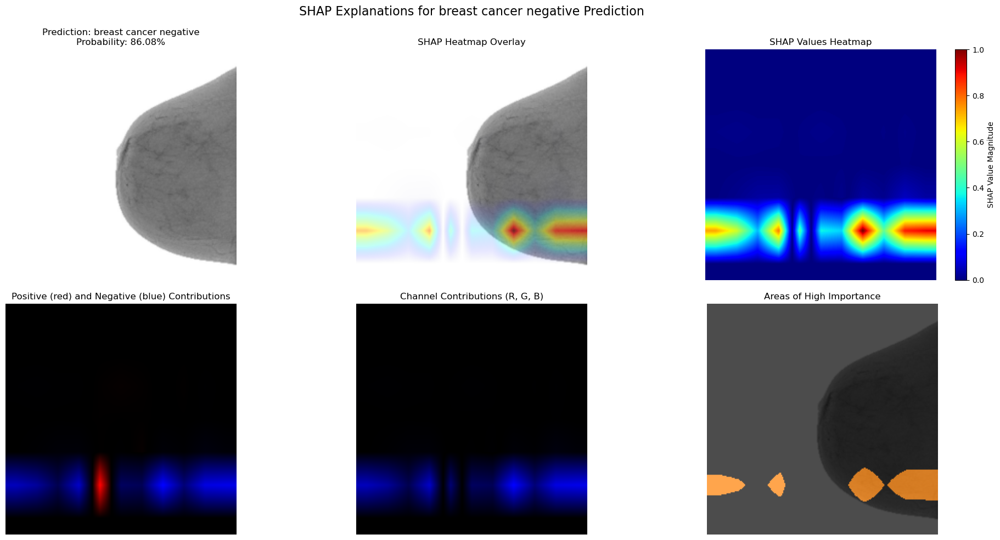

<Figure size 1000x600 with 0 Axes>

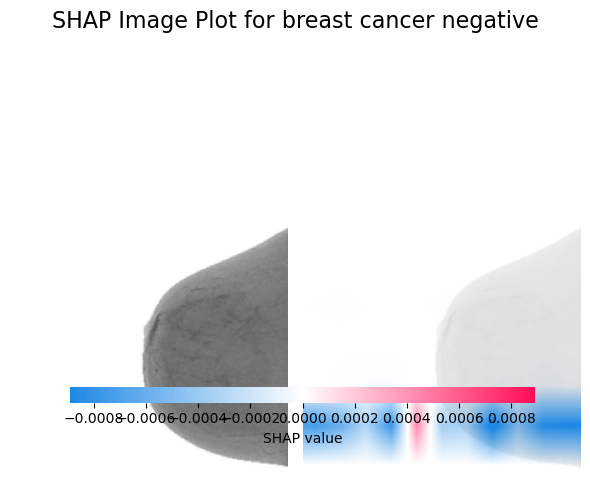

SHAP generation time: 65.4700 seconds


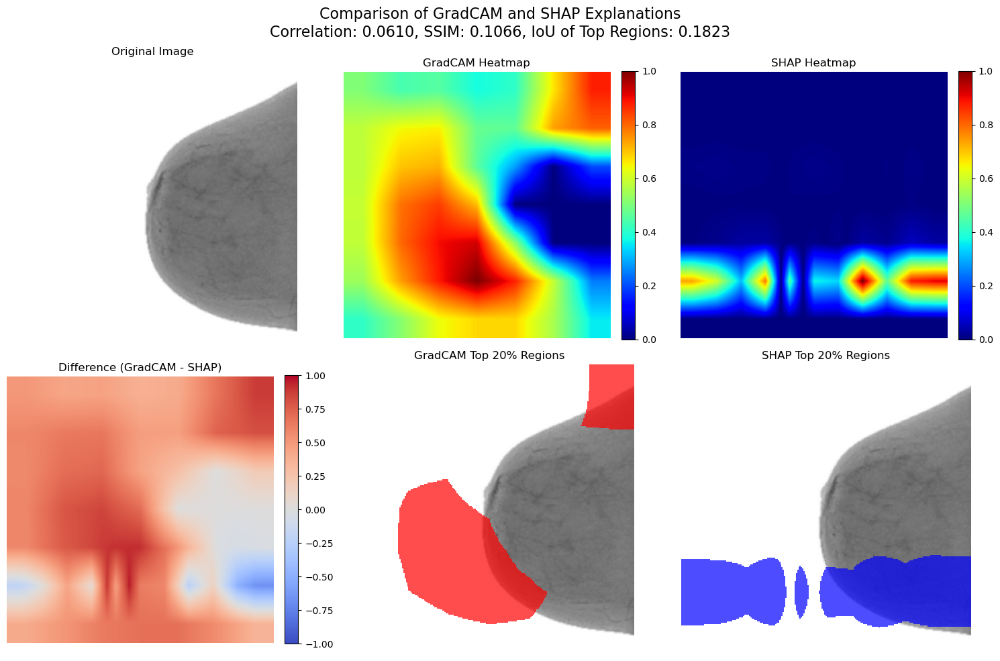


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.0610
SSIM between heatmaps: 0.1066
IoU of top 20% regions: 0.1823
GradCAM execution time: 0.1965 seconds
SHAP execution time: 65.4700 seconds

=== Evaluation Summary ===
Total images evaluated: 11
Average prediction confidence: 97.89%

GradCAM metrics:
  Average execution time: 0.22 seconds
  Average energy concentration: 0.4366

SHAP metrics:
  Average execution time: 62.17 seconds
  Average energy concentration: 0.8313

Comparison metrics:
  Average correlation: 0.1435
  Average SSIM: 0.1887
  Average IoU: 0.1750


,image_path,diagnosis_area,predicted_class,confidence,gradcam_time,gradcam_energy,shap_time,shap_energy,correlation,ssim,iou
0,/Users/academiccity/Documents/amokorankye/deep...,Brain Tumors,pituitary,1.000000,0.191283,0.475022,60.665517,0.940949,0.409520,0.246517,0.417473
1,/Users/academiccity/Documents/amokorankye/deep...,Bone Fractures,bone fractured,1.000000,0.166812,0.522336,62.030725,0.877912,0.384543,0.246388,0.287116
2,/Users/academiccity/Documents/amokorankye/deep...,Brain Tumors,healthy brain,1.000000,0.162957,0.490539,60.981895,0.590414,0.650259,0.391545,0.297769
3,/Users/academiccity/Documents/amokorankye/deep...,Lung Cancer,adenocarcinoma,1.000000,0.275991,0.313354,61.776491,0.589218,0.486873,0.286160,0.210495
4,/Users/academiccity/Documents/amokorankye/deep...,Brain Tumors,glioma,0.925251,0.195871,0.428331,61.087187,0.700770,0.445724,0.256774,0.299029
5,/Users/academiccity/Documents/amokorankye/deep...,Lung Cancer,benign,1.000000,0.288028,0.340048,64.152338,0.964820,-0.567302,0.045674,0.000000
6,/Users/academiccity/Documents/amokorankye/deep...,Breast Cancer,breast cancer positive,0.981722,0.147827,0.414978,61.468641,0.847546,0.024839,0.087933,0.170255
7,/Users/academiccity/Documents/amokorankye/deep...,Bone Fractures,bone not fractured,0.999996,0.210660,0.539927,62.091045,0.902390,-0.134442,0.215134,0.014405
8,/Users/academiccity/Documents/amokorankye/deep...,Lung Cancer,squamous cell carcinoma,0.999999,0.313485,0.473508,62.252048,0.927659,-0.162109,0.049858,0.001868
9,/Users/academiccity/Documents/amokorankye/deep...,Brain Tumors,meningioma,1.000000,0.224550,0.493490,62.746018,0.919679,-0.019888,0.142869,0.044333


In [21]:
import os
import time
import numpy as np
from tqdm.notebook import tqdm
import pandas as pd

# Define the list of test images
test_images = []

# Path to your test images directory
test_dir = "/Users/academiccity/Documents/amokorankye/deep learning final exam/test data"

# Collect valid image paths
for root, _, files in os.walk(test_dir):
    for filename in files:
        if filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
            test_images.append(os.path.join(root, filename))

print(f"Found {len(test_images)} images for evaluation")

# Systematic evaluation of test images using both prediction and explainability methods

# Define which evaluation methods to use
run_prediction = True
run_gradcam = True
run_shap = True  # SHAP is computationally intensive, so we can toggle it
run_comparison = True  # Compare GradCAM and SHAP

# Set sample size for SHAP (smaller is faster but less accurate)
shap_sample_size = 50

# Store results
results = []

# Process test images with progress bar
for image_path in tqdm(test_images, desc="Evaluating images"):
    # Determine diagnosis area from the image path or filename
    filename = os.path.basename(image_path).lower()
    parent_dir = os.path.basename(os.path.dirname(image_path)).lower()
    
    if any(x in parent_dir for x in ['glioma', 'meningioma', 'pituitary', 'healthy brain']):
        diagnosisArea = "Brain Tumors"
    elif any(x in parent_dir for x in ['breast']):
        diagnosisArea = "Breast Cancer"
    elif any(x in parent_dir for x in ['bone', 'fracture']):
        diagnosisArea = "Bone Fractures"
    elif any(x in parent_dir for x in ['adenocarcinoma', 'squamous', 'benign']):
        diagnosisArea = "Lung Cancer"
    else:
        diagnosisArea = None
    
    result = {"image_path": image_path, "diagnosis_area": diagnosisArea}
    
    # Run prediction
    if run_prediction:
        pred = predict(image_path, diagnosisArea)
        if pred:
            result.update({
                "predicted_class": pred['diagnosis'],
                "confidence": pred['confidence']
            })
    
    # Run GradCAM evaluation
    if run_gradcam:
        try:
            start_time = time.time()
            cam = apply_gradcam(image_path, comprehensive_model, comprehensive_model.layer4[-1])
            gradcam_time = time.time() - start_time
            
            if cam is not None:
                # Calculate energy concentration
                cam_sorted = np.sort(cam.flatten())[::-1]
                energy_concentration = np.sum(cam_sorted[:int(0.2*len(cam_sorted))]) / np.sum(cam_sorted)
                
                result.update({
                    "gradcam_time": gradcam_time,
                    "gradcam_energy": energy_concentration
                })
        except Exception as e:
            print(f"GradCAM error for {filename}: {str(e)}")
    
    # Run SHAP evaluation (on a subset due to computational cost)
    if run_shap:
        try:
            # Get target class from prediction
            target_class = classes.index(result["predicted_class"]) if "predicted_class" in result else None
            
            start_time = time.time()
            shap_values, _ = apply_shap(image_path, comprehensive_model, target_class, n_samples=shap_sample_size)
            shap_time = time.time() - start_time
            
            if shap_values is not None:
                # Aggregate SHAP values
                shap_magnitude = np.sum(np.abs(shap_values), axis=0)
                
                # Calculate metrics
                shap_sorted = np.sort(shap_magnitude.flatten())[::-1]
                energy_concentration = np.sum(shap_sorted[:int(0.2*len(shap_sorted))]) / np.sum(shap_sorted)
                
                result.update({
                    "shap_time": shap_time,
                    "shap_energy": energy_concentration
                })
        except Exception as e:
            print(f"SHAP error for {filename}: {str(e)}")
    
    # Compare GradCAM and SHAP if both were successful
    if run_comparison and "gradcam_time" in result and "shap_time" in result:
        try:
            comparison = compare_explainability_methods(image_path, diagnosisArea)
            if comparison:
                result.update({
                    "correlation": comparison["correlation"],
                    "ssim": comparison["ssim"],
                    "iou": comparison["iou"]
                })
        except Exception as e:
            print(f"Comparison error for {filename}: {str(e)}")
    
    # Add result to collection
    results.append(result)

# Convert results to dataframe for easier analysis
results_df = pd.DataFrame(results)

# Display summary statistics
print("\n=== Evaluation Summary ===")
print(f"Total images evaluated: {len(results_df)}")
if 'confidence' in results_df.columns and len(results_df) > 0:
    print(f"Average prediction confidence: {results_df['confidence'].mean():.2%}")

if 'gradcam_time' in results_df.columns:
    print(f"\nGradCAM metrics:")
    print(f"  Average execution time: {results_df['gradcam_time'].mean():.2f} seconds")
    print(f"  Average energy concentration: {results_df['gradcam_energy'].mean():.4f}")

if 'shap_time' in results_df.columns:
    print(f"\nSHAP metrics:")
    print(f"  Average execution time: {results_df['shap_time'].mean():.2f} seconds")
    print(f"  Average energy concentration: {results_df['shap_energy'].mean():.4f}")

if 'correlation' in results_df.columns:
    print(f"\nComparison metrics:")
    print(f"  Average correlation: {results_df['correlation'].mean():.4f}")
    print(f"  Average SSIM: {results_df['ssim'].mean():.4f}")
    print(f"  Average IoU: {results_df['iou'].mean():.4f}")

# Display the dataframe
results_df

Sanity Checks

In [26]:
import copy
import os
import torch
import torchvision.models as models
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import spearmanr

# Create a new model with the same architecture instead of deepcopying
random_model = models.resnet18(pretrained=False)  # New instance with random weights

# Modify the final FC layer to match our class count
num_ftrs = random_model.fc.in_features
random_model.fc = torch.nn.Linear(num_ftrs, len(classes))

def perform_sanity_checks(image_path, diagnosisArea, model=comprehensive_model, 
                         target_layer=comprehensive_model.layer4[-1]):
    """
    Perform sanity checks on explainability methods following Adebayo et al.
    Tests if attribution methods are sensitive to model parameters by comparing
    explanations from trained model vs. models with randomized weights or outputs.
    """
    
    print(f"\n=== Sanity Checks for Explainability Methods ===")
    print(f"Testing image: {os.path.basename(image_path)}")
    
    # Step 1: Get explanations with original trained model
    print("\nGenerating explanations with trained model...")
    # Original prediction
    orig_pred = predict(image_path, diagnosisArea)
    orig_class = orig_pred['diagnosis'] if orig_pred else None
    orig_class_idx = classes.index(orig_class) if orig_class in classes else None
    
    # Original GradCAM
    orig_gradcam = apply_gradcam(image_path, model, target_layer)
    
    # Original SHAP
    orig_shap_values, img_display = apply_shap(image_path, model, orig_class_idx, n_samples=50)
    orig_shap_magnitude = np.sum(np.abs(orig_shap_values), axis=0) if orig_shap_values is not None else None
    
    # Step 2: Use the pre-created model with randomized weights
    print("\nGenerating explanations with randomized weights...")
    # Use the random_model we created outside the function instead of deepcopying
    
    # Random model GradCAM
    random_gradcam = apply_gradcam(image_path, random_model, random_model.layer4[-1])
    
    # Random model SHAP
    random_shap_values, _ = apply_shap(image_path, random_model, orig_class_idx, n_samples=50)
    random_shap_magnitude = np.sum(np.abs(random_shap_values), axis=0) if random_shap_values is not None else None
    
    # Step 3: Create model that produces random outputs (simulates random labels)
    print("\nGenerating explanations with randomized outputs...")
    
    # Define a model wrapper that outputs random predictions but maintains gradients
    class RandomOutputModel(torch.nn.Module):
        def __init__(self, base_model):
            super().__init__()
            self.base_model = base_model
            # Keep the feature extractor part intact for GradCAM
            self.layer4 = base_model.layer4  # Reference to the target layer for GradCAM
            
        def forward(self, x):
            # Get the original features (needed for GradCAM)
            features = self.base_model.conv1(x)
            features = self.base_model.bn1(features)
            features = self.base_model.relu(features)
            features = self.base_model.maxpool(features)
            
            features = self.base_model.layer1(features)
            features = self.base_model.layer2(features)
            features = self.base_model.layer3(features)
            features = self.base_model.layer4(features)
            
            # Create a random output tensor that's gradient-enabled and connected to input
            batch_size = x.size(0)
            random_output = torch.randn(batch_size, len(classes), device=x.device)
            # Multiply by a tiny factor of features to maintain gradient flow
            avg_features = torch.nn.functional.adaptive_avg_pool2d(features, (1, 1))
            avg_features = torch.flatten(avg_features, 1)
            # Scale to avoid affecting the randomness too much
            connected_output = random_output + 0.0001 * torch.sum(avg_features, dim=1, keepdim=True)
            
            return connected_output
    
    random_output_model = RandomOutputModel(model)
    
    try:
        # Random output model GradCAM
        random_output_gradcam = apply_gradcam(image_path, random_output_model, random_output_model.layer4[-1])
    except Exception as e:
        print(f"Error applying GradCAM: {str(e)}")
        random_output_gradcam = np.zeros_like(orig_gradcam) if orig_gradcam is not None else None
    
    try:
        # Random output model SHAP
        random_output_shap_values, _ = apply_shap(image_path, random_output_model, orig_class_idx, n_samples=50)
        random_output_shap_magnitude = np.sum(np.abs(random_output_shap_values), axis=0) if random_output_shap_values is not None else None
    except Exception as e:
        print(f"Error applying SHAP: {str(e)}")
        random_output_shap_magnitude = np.zeros_like(orig_shap_magnitude) if orig_shap_magnitude is not None else None
    
    # Step 4: Analyze and visualize the differences
    # Visual comparison - GradCAM
    if orig_gradcam is not None and random_gradcam is not None and random_output_gradcam is not None:
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(orig_gradcam, cmap='jet')
        plt.title(f"Original Model\nGradCAM")
        plt.axis('off')
        
        plt.subplot(1, 3, 2)
        plt.imshow(random_gradcam, cmap='jet')
        plt.title("Random Weights\nGradCAM")
        plt.axis('off')
        
        plt.subplot(1, 3, 3)
        plt.imshow(random_output_gradcam, cmap='jet')
        plt.title("Random Outputs\nGradCAM")
        plt.axis('off')
        
        plt.suptitle("GradCAM Sanity Check: Good methods should show noise for randomized models", fontsize=14)
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()
    
    # Visual comparison - SHAP
    if orig_shap_magnitude is not None and random_shap_magnitude is not None and random_output_shap_magnitude is not None:
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(orig_shap_magnitude, cmap='jet')
        plt.title(f"Original Model\nSHAP")
        plt.axis('off')
        
        plt.subplot(1, 3, 2)
        plt.imshow(random_shap_magnitude, cmap='jet')
        plt.title("Random Weights\nSHAP")
        plt.axis('off')
        
        plt.subplot(1, 3, 3)
        plt.imshow(random_output_shap_magnitude, cmap='jet')
        plt.title("Random Outputs\nSHAP")
        plt.axis('off')
        
        plt.suptitle("SHAP Sanity Check: Good methods should show noise for randomized models", fontsize=14)
        plt.tight_layout()
        plt.subplots_adjust(top=0.85)
        plt.show()
    
    # Compute metrics - correlation between original and random explanations
    print("\n=== Quantitative Sanity Check Results ===")
    
    # For GradCAM
    if orig_gradcam is not None and random_gradcam is not None:
        orig_vs_random_weights_corr_gradcam = np.corrcoef(orig_gradcam.flatten(), random_gradcam.flatten())[0, 1]
        orig_vs_random_output_corr_gradcam = np.corrcoef(orig_gradcam.flatten(), 
                                                       random_output_gradcam.flatten() if random_output_gradcam is not None else np.zeros_like(orig_gradcam).flatten())[0, 1]
        
        # Additional metric: rank correlation (Spearman's rho)
        spearman_orig_vs_random_gradcam = spearmanr(orig_gradcam.flatten(), random_gradcam.flatten())[0]
        
        print(f"GradCAM correlation (original vs random weights): {orig_vs_random_weights_corr_gradcam:.4f}")
        print(f"GradCAM correlation (original vs random outputs): {orig_vs_random_output_corr_gradcam:.4f}")
        print(f"GradCAM rank correlation (original vs random): {spearman_orig_vs_random_gradcam:.4f}")
    
    # For SHAP
    if orig_shap_magnitude is not None and random_shap_magnitude is not None:
        orig_vs_random_weights_corr_shap = np.corrcoef(orig_shap_magnitude.flatten(), random_shap_magnitude.flatten())[0, 1]
        orig_vs_random_output_corr_shap = np.corrcoef(orig_shap_magnitude.flatten(), 
                                                   random_output_shap_magnitude.flatten() if random_output_shap_magnitude is not None else np.zeros_like(orig_shap_magnitude).flatten())[0, 1]
        
        # Rank correlation
        spearman_orig_vs_random_shap = spearmanr(orig_shap_magnitude.flatten(), random_shap_magnitude.flatten())[0]
        
        print(f"SHAP correlation (original vs random weights): {orig_vs_random_weights_corr_shap:.4f}")
        print(f"SHAP correlation (original vs random outputs): {orig_vs_random_output_corr_shap:.4f}")
        print(f"SHAP rank correlation (original vs random): {spearman_orig_vs_random_shap:.4f}")
    
    print("\n=== Interpretation ===")
    print("Lower correlation values (close to 0) indicate the method passes the sanity check.")
    print("High correlations suggest the method might be independent of model parameters.")
    
    # Energy concentration comparison
    def compute_energy_concentration(heatmap):
        if heatmap is None:
            return 0.0
        sorted_values = np.sort(heatmap.flatten())[::-1]
        return np.sum(sorted_values[:int(0.2*len(sorted_values))]) / np.sum(sorted_values) if np.sum(sorted_values) > 0 else 0.0
    
    orig_energy_gradcam = compute_energy_concentration(orig_gradcam)
    random_energy_gradcam = compute_energy_concentration(random_gradcam)
    orig_energy_shap = compute_energy_concentration(orig_shap_magnitude)
    random_energy_shap = compute_energy_concentration(random_shap_magnitude)
    
    print(f"\nGradCAM energy concentration (original): {orig_energy_gradcam:.4f}")
    print(f"GradCAM energy concentration (random): {random_energy_gradcam:.4f}")
    print(f"SHAP energy concentration (original): {orig_energy_shap:.4f}")
    print(f"SHAP energy concentration (random): {random_energy_shap:.4f}")
    
    return {
        "gradcam_correlation": orig_vs_random_weights_corr_gradcam if 'orig_vs_random_weights_corr_gradcam' in locals() else None,
        "gradcam_rank_correlation": spearman_orig_vs_random_gradcam if 'spearman_orig_vs_random_gradcam' in locals() else None,
        "shap_correlation": orig_vs_random_weights_corr_shap if 'orig_vs_random_weights_corr_shap' in locals() else None,
        "shap_rank_correlation": spearman_orig_vs_random_shap if 'spearman_orig_vs_random_shap' in locals() else None,
        "gradcam_energy_orig": orig_energy_gradcam,
        "gradcam_energy_random": random_energy_gradcam,
        "shap_energy_orig": orig_energy_shap,
        "shap_energy_random": random_energy_shap
    }

/opt/anaconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/anaconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)



=== Sanity Checks for Explainability Methods ===
Testing image: glioma.jpg

Generating explanations with trained model...

Diagnosis Results:
Classification: glioma
Confidence: 92.53%

Class Probabilities:
pituitary: 7.38%
healthy brain: 0.00%
glioma: 92.53%
meningioma: 0.09%


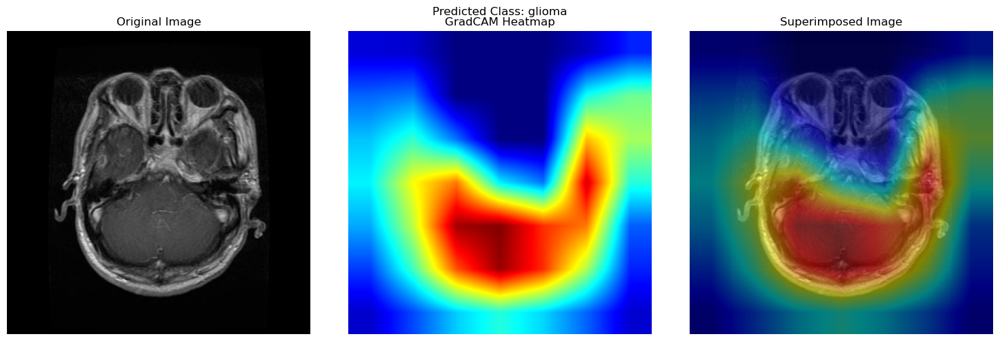

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


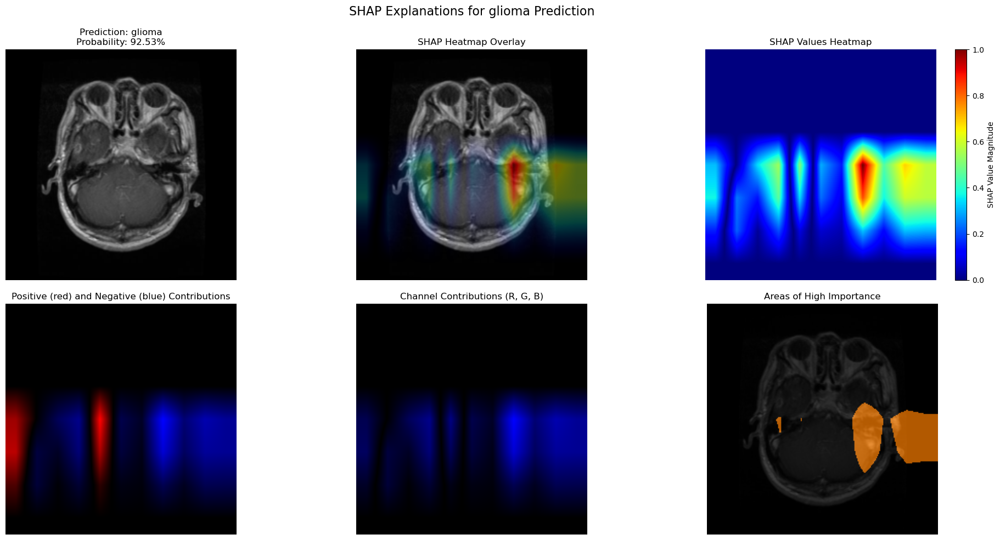

/var/folders/2z/km3f0zgd0hzf9zk_ctnxyzzw0000gn/T/ipykernel_13908/146183786.py:205: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


<Figure size 1000x600 with 0 Axes>

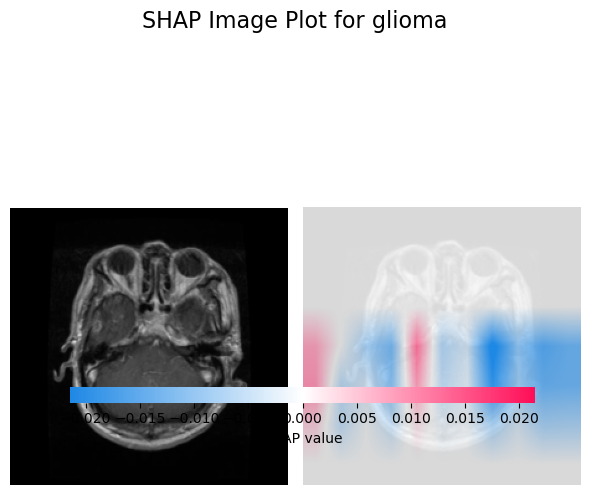


Generating explanations with randomized weights...


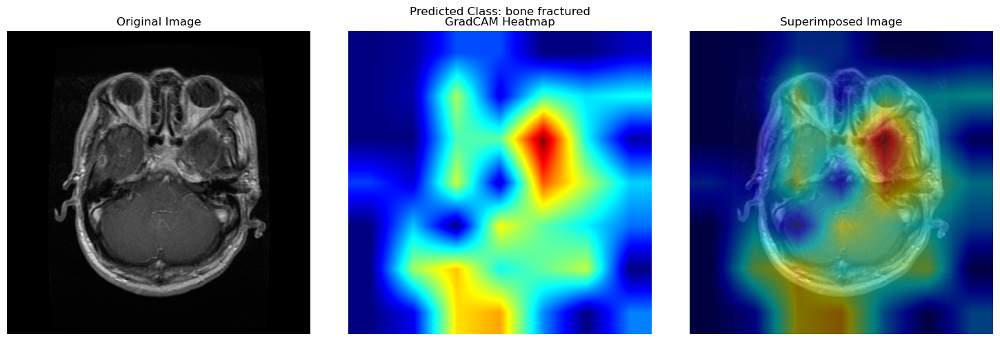

Error applying SHAP: list index out of range

Generating explanations with randomized outputs...


Traceback (most recent call last):
  File "/var/folders/2z/km3f0zgd0hzf9zk_ctnxyzzw0000gn/T/ipykernel_13908/146183786.py", line 63, in apply_shap
    shap_for_class = shap_values[class_idx]
                     ~~~~~~~~~~~^^^^^^^^^^^
IndexError: list index out of range


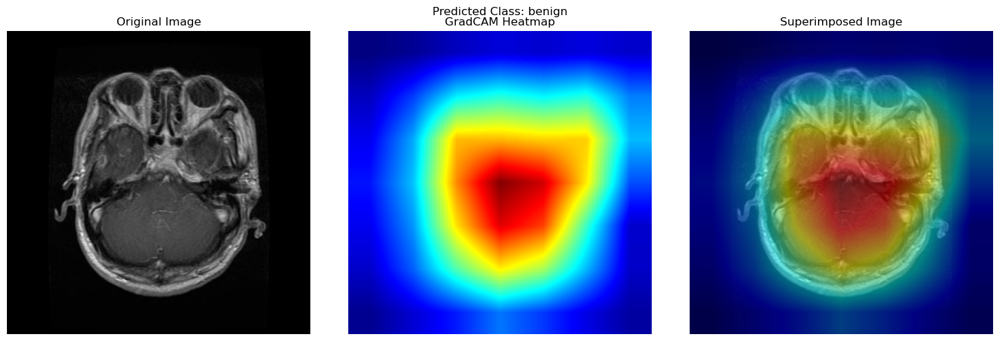

Error applying SHAP: list index out of range


Traceback (most recent call last):
  File "/var/folders/2z/km3f0zgd0hzf9zk_ctnxyzzw0000gn/T/ipykernel_13908/146183786.py", line 63, in apply_shap
    shap_for_class = shap_values[class_idx]
                     ~~~~~~~~~~~^^^^^^^^^^^
IndexError: list index out of range


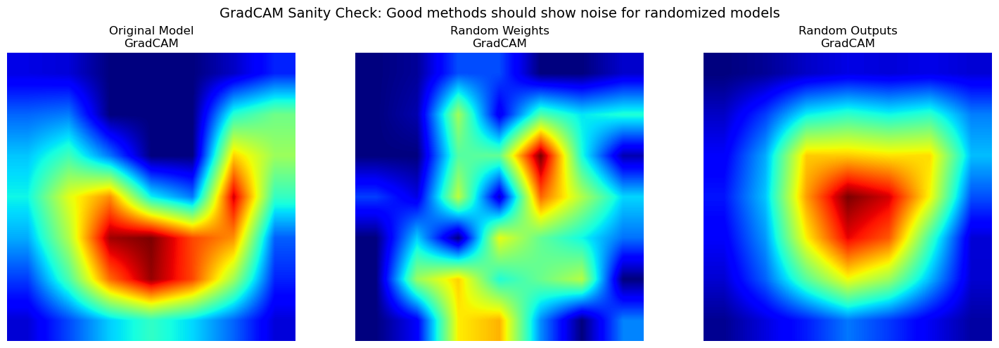


=== Quantitative Sanity Check Results ===
GradCAM correlation (original vs random weights): 0.3959
GradCAM correlation (original vs random outputs): 0.5561
GradCAM rank correlation (original vs random): 0.4364

=== Interpretation ===
Lower correlation values (close to 0) indicate the method passes the sanity check.
High correlations suggest the method might be independent of model parameters.

GradCAM energy concentration (original): 0.4283
GradCAM energy concentration (random): 0.4147
SHAP energy concentration (original): 0.7032
SHAP energy concentration (random): 0.0000


{'gradcam_correlation': 0.39593560550929285,
 'gradcam_rank_correlation': 0.4363555859695598,
 'shap_correlation': None,
 'shap_rank_correlation': None,
 'gradcam_energy_orig': 0.42833093,
 'gradcam_energy_random': 0.41471782,
 'shap_energy_orig': 0.703239587168991,
 'shap_energy_random': 0.0}

In [27]:
perform_sanity_checks(image_path = "/Users/academiccity/Documents/amokorankye/deep learning final exam/test data/glioma/glioma.jpg", 
                      diagnosisArea = "Brain Tumors", 
                      model=comprehensive_model, 
                      target_layer=comprehensive_model.layer4[-1]
)